# `l2hmc`: Example

<a href="https://arxiv.org/abs/2105.03418"><img alt="arxiv" src="http://img.shields.io/badge/arXiv-2105.03418-B31B1B.svg" align="left"></a> <a href="https://arxiv.org/abs/2112.01582"><img alt="arxiv" src="http://img.shields.io/badge/arXiv-2112.01582-B31B1B.svg" align="left" style="margin-left:10px;"></a><br>


This notebook will (attempt) to walk through the steps needed to successfully instantiate and "run" an experiment.

For this example, we wish to train the L2HMC sampler for the 2D $U(1)$ lattice gauge model with Wilson action:

$$
S_{\beta}(n) = \beta \sum_{n}\sum_{\mu<\nu}\mathrm{Re}\left[1 - U_{\mu\nu}(n) \right]
$$

This consists of the following steps:
  1. Build an `Experiment` by parsing our configuration object
  2. Train our model using the `Experiment.train()` method
  3. Evaluate our trained model `Experiment.evaluate(job_type='eval')`
  4. Compare our trained models' performance against generic HMC `Experiment.evaluate(job_type='hmc')`
  

<div class="alert alert-block alert-info" style="background:rgba(102, 102, 102, 0.1);color:#666666; border-radius:5px; border: none;">
<span style="font-weight:700; font-size:1.5em;">Evaluating Performance</span>
    
Explicitly, we measure the performance of our model by comparing the _tunneling rate_ $\delta Q$ of our **trained** sampler to that of generic HMC.
    
Explicitly, the tunneling rate is given by:
    
$$
\delta Q = \frac{1}{N_{\mathrm{chains}}}\sum_{\mathrm{chains}} \left|Q_{i+1} - Q_{i}\right|
$$
    
where the difference is between subsequent states in a chain, and the sum is over all $N$ chains (each being ran in parallel, _independently_).
    
Since our goal is to generate _independent configurations_, the more our sampler tunnels between different topological sectors (_tunneling rate_), the more efficient our sampler.
    
</div>


## Imports / Setup

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib widget

import os
import warnings

warnings.filterwarnings('ignore')
os.environ['TORCH_CPP_LOG_LEVEL'] = 'ERROR'
os.environ['AUTOGRAPH_VERBOSITY'] = '10'
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
!echo $CUDA_VISIBLE_DEVICES

0


In [2]:
from __future__ import absolute_import, print_function, annotations, division

import logging
from rich.style import Style
from rich.console import Console
from rich.logging import RichHandler
from l2hmc.utils.rich import get_console
from l2hmc.utils.plot_helpers import set_plot_style
from l2hmc.main import build_experiment

set_plot_style()

console = get_console()

log = logging.getLogger()

handler = RichHandler(
    rich_tracebacks=True,
    tracebacks_show_locals=True,
    console=console,
    show_path=False,
    log_time_format='[%H:%m:%S]',
    enable_link_path=False,
)

log.handlers = [handler]

log.setLevel('INFO')

tlog = logging.getLogger('torch')
tlog.setLevel('ERROR')

wblog = logging.getLogger('wandb')
wblog.setLevel('CRITICAL')

--------------------------------------------------------------------------

  Local host:   thetagpu24
  Local device: mlx5_0
--------------------------------------------------------------------------


# Initialize and Build `Experiment` objects:

- The `l2hmc.main` module provides a function `build_experiment`:

```python
def build_experiment(overrides: list[str]) -> tfExperiment | ptExperiment:
    ...
```

which will:

1. Load the default options from `conf/config.yaml`
2. Override the default options with any values provided in `overrides`
3. Parse these options and build an `ExperimentConfig` which uniquely defines an experiment
3. Instantiate / return an `Experiment` from the `ExperimentConfig`.
   Depending on `framework=pytorch|tensorflow`:
    a. `framework=pytorch` -> `l2hmc.experiment.pytorch.Experiment`
    b. `framework=tensorflow` -> `l2hmc.experiment.tensorflow.Experiment`

```python
>>> train_output = experiment.train()
>>> eval_output = experiment.evaluate(job_type='eval')
>>> hmc_output = experiment.evaluate(job_type='hmc')
```

<div class="alert alert-block alert-info" style="background:rgba(102, 102, 102, 0.2);color:rgb(102,102,102); border-radius:5px; border:none">
<b><u>Overriding Defaults</u></b>

Specifics about the training / evaluation / hmc runs can be flexibly overridden by passing arguments to the training / evaluation / hmc runs, respectively
</div>

In [5]:
import numpy as np

seed = np.random.randint(1)

defaults = [
    'conv=none',
    f'seed={seed}',
    # ---------------------------------
    'steps.nera=5',
    'steps.nepoch=1000',
    'steps.print=500',
    'steps.log=50',
    'steps.test=1000',
    # ---------------------------------
    'annealing_schedule.beta_init=4.0',
    'annealing_schedule.beta_final=5.0',
    # ---------------------------------
    'init_aim=false',
    'init_wandb=false',
]

outputs = {
    'pytorch': {
        'train': {},
        'eval': {},
        'hmc': {},
    },
    'tensorflow': {
        'train': {},
        'eval': {},
        'hmc': {},
    },
}

## Pytorch

In [6]:
ptExpU1 = build_experiment(
    overrides=[
        *defaults,
        'framework=pytorch',
        'backend=DDP',
        'precision=fp16',
    ]
)

[22:02:24] INFO     Caught MASTER_PORT:2345 from environment!

           INFO     Global Rank: 0 / 0

[22:02:06] INFO     Caught MASTER_PORT:2345 from environment!

           INFO     Caught MASTER_PORT:2345 from environment!

           WARNING  Using torch.float16 on cuda!

[22:02:09] INFO     Looking for checkpoints in:                                              
                     /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/projects/l2hmc-qcd
                    /src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/sepnets-True/merge-Tr
                    ue/net-16-16-16_dp-0.2_bn-False/pytorch

           INFO     Loading model from: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU
                    /projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/se
                    pnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-4-0-3340
                    1-2023-02-09-072640.pth

[22:02:10] INFO     Loading checkpoint from: /lus/grand/projects/DLHMC/foremans/locations/the
                    taGPU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-Tr
                    ue/sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-4-0-
                    33401-2023-02-09-072640.tar

           WARNING  Restoring global step from ckpt! self._gstep: 33401

           WARNING  Using `torch.optim.Adam` optimizer

## TensorFlow

In [7]:
tfExpU1 = build_experiment(
    overrides=[
        *defaults,
        'framework=tensorflow',
        'backend=horovod',
    ]
)

[22:02:30] INFO     1, Physical GPUs and 1 Logical GPUs

           WARNING  Using: float32 precision

           INFO     RANK: 0, LOCAL_RANK: 0

# Training

## PyTorch

### Training

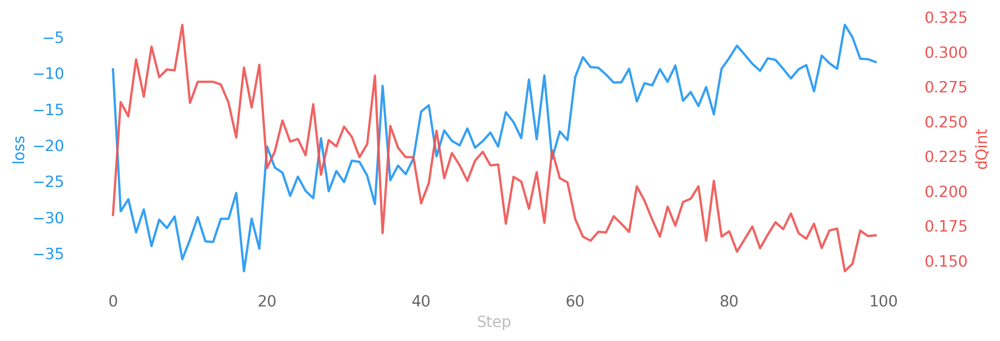

[22:02:39] INFO     [TRAINING] x.dtype: torch.float32

           INFO     [TRAINING] self._dtype: torch.float16

────────────────────────────────── ERA: 0 / 4, BETA: 4.000 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[22:02:48] INFO     era=0   epoch=0   tstep=33402 dt=0.2923 beta=4.0000 loss=-9.5288         
                    dQsin=0.1659 dQint=0.1828 energy=540.5661 logprob=441.1455 logdet=99.4206
                    sldf=347.7266 sldb=-347.7220 sld=99.4206 xeps=0.2020 veps=0.1744         
                    acc=0.1551 sumlogdet=-0.0038 acc_mask=0.1660 plaqs=0.8633 intQ=0.0323    
                    sinQ=0.0267 lr=0.0010

[22:02:38] INFO     era=0   epoch=500 tstep=33902 dt=0.2471 beta=4.0000 loss=-33.1296        
                    dQsin=0.2451 dQint=0.2632 energy=546.3675 logprob=444.2349               
                    logdet=102.1325 sldf=387.9519 sldb=-387.9485 sld=102.1325 xeps=0.1995    
                    veps=0.1902 acc=0.2791 sumlogdet=0.0110 acc_mask=0.2798 plaqs=0.8638     
                    intQ=0.0185 sinQ=0.0102 lr=0.0010

[22:02:25] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/
                    sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-0-0-344
                    01-2023-02-14-224224.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-0-0-344
                    01-2023-02-14-224224.pth

           INFO     Saving took: 0.156199s

           INFO     Era 0 took: 345.418s

────────────────────────────────── ERA: 1 / 4, BETA: 4.250 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[22:02:33] INFO     era=1   epoch=0   tstep=34402 dt=0.2585 beta=4.2500 loss=-20.2218        
                    dQsin=0.2108 dQint=0.2164 energy=553.7194 logprob=447.2904               
                    logdet=106.4289 sldf=413.9837 sldb=-413.9333 sld=106.4289 xeps=0.1939    
                    veps=0.2064 acc=0.3078 sumlogdet=-0.0039 acc_mask=0.3052 plaqs=0.8726    
                    intQ=0.0137 sinQ=0.0049 lr=0.0010

[22:02:22] INFO     era=1   epoch=500 tstep=34902 dt=0.2436 beta=4.2500 loss=-25.1668        
                    dQsin=0.2411 dQint=0.2461 energy=554.5172 logprob=448.1080               
                    logdet=106.4092 sldf=410.6092 sldb=-410.6385 sld=106.4092 xeps=0.1965    
                    veps=0.2001 acc=0.3217 sumlogdet=-0.0003 acc_mask=0.3213 plaqs=0.8730    
                    intQ=0.0273 sinQ=0.0255 lr=0.0010

[22:02:08] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/
                    sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-1-0-354
                    01-2023-02-14-224808.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-1-0-354
                    01-2023-02-14-224808.pth

           INFO     Saving took: 0.308018s

           INFO     Era 1 took: 343.821s

           INFO     Avgs over last era:                                                      
                     tstep=34877.0000, dt=0.2425, beta=4.2500, loss=-23.4688, dQsin=0.2275,  
                    dQint=0.2328, energy=554.8514, logprob=448.7472, logdet=106.1042,        
                    sldf=411.4143, sldb=-411.4171, sld=106.1042, xeps=0.1969, veps=0.1996,   
                    acc=0.3094, sumlogdet=0.0023, acc_mask=0.3063, plaqs=0.8726,             
                    intQ=-0.0075, sinQ=-0.0079, lr=0.0010                                    
           

────────────────────────────────── ERA: 2 / 4, BETA: 4.500 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[22:02:18] INFO     era=2   epoch=0   tstep=35402 dt=0.2424 beta=4.5000 loss=-15.3824        
                    dQsin=0.1891 dQint=0.1910 energy=557.5576 logprob=450.8825               
                    logdet=106.6750 sldf=412.1216 sldb=-412.0482 sld=106.6750 xeps=0.1986    
                    veps=0.1948 acc=0.2938 sumlogdet=0.0030 acc_mask=0.2935 plaqs=0.8799     
                    intQ=-0.0015 sinQ=0.0026 lr=0.0010

[22:02:10] INFO     era=2   epoch=500 tstep=35902 dt=0.2440 beta=4.5000 loss=-20.2406        
                    dQsin=0.2201 dQint=0.2189 energy=550.9757 logprob=446.1743               
                    logdet=104.8014 sldf=402.1904 sldb=-402.2429 sld=104.8014 xeps=0.1996    
                    veps=0.1901 acc=0.3308 sumlogdet=-0.0102 acc_mask=0.3335 plaqs=0.8804    
                    intQ=-0.0171 sinQ=-0.0140 lr=0.0010

[22:02:55] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/
                    sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-2-0-364
                    01-2023-02-14-225355.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-2-0-364
                    01-2023-02-14-225355.pth

           INFO     Saving took: 0.175848s

           INFO     Era 2 took: 346.666s

           INFO     Avgs over last era:                                                      
                     tstep=35877.0000, dt=0.2452, beta=4.5000, loss=-17.8211, dQsin=0.2078,  
                    dQint=0.2102, energy=551.8356, logprob=447.1612, logdet=104.6745,        
                    sldf=399.4591, sldb=-399.4556, sld=104.6745, xeps=0.1994, veps=0.1899,   
                    acc=0.3045, sumlogdet=0.0040, acc_mask=0.3044, plaqs=0.8804, intQ=0.0025,
                    sinQ=0.0028, lr=0.0010                                                   
           

────────────────────────────────── ERA: 3 / 4, BETA: 4.750 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[22:02:03] INFO     era=3   epoch=0   tstep=36402 dt=0.2413 beta=4.7500 loss=-10.5958        
                    dQsin=0.1866 dQint=0.1798 energy=550.2097 logprob=446.1068               
                    logdet=104.1028 sldf=394.4366 sldb=-394.4626 sld=104.1028 xeps=0.1989    
                    veps=0.1881 acc=0.3064 sumlogdet=0.0083 acc_mask=0.3052 plaqs=0.8867     
                    intQ=-0.0058 sinQ=-0.0046 lr=0.0010

[22:02:36] INFO     era=3   epoch=500 tstep=36902 dt=0.4443 beta=4.7500 loss=-11.7377        
                    dQsin=0.1853 dQint=0.1793 energy=546.7579 logprob=443.8261               
                    logdet=102.9318 sldf=395.2623 sldb=-395.2884 sld=102.9318 xeps=0.1955    
                    veps=0.1881 acc=0.3516 sumlogdet=-0.0087 acc_mask=0.3462 plaqs=0.8872    
                    intQ=-0.0212 sinQ=-0.0161 lr=0.0010

[23:02:25] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/
                    sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-3-0-374
                    01-2023-02-14-230125.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-3-0-374
                    01-2023-02-14-230125.pth

           INFO     Saving took: 0.159622s

           INFO     Era 3 took: 450.073s

           INFO     Avgs over last era:                                                      
                     tstep=36877.0000, dt=0.3097, beta=4.7500, loss=-11.2259, dQsin=0.1874,  
                    dQint=0.1807, energy=548.9434, logprob=445.0977, logdet=103.8456,        
                    sldf=394.7209, sldb=-394.7327, sld=103.8456, xeps=0.1960, veps=0.1884,   
                    acc=0.3310, sumlogdet=-0.0024, acc_mask=0.3313, plaqs=0.8872,            
                    intQ=-0.0080, sinQ=-0.0074, lr=0.0010                                    
           

────────────────────────────────── ERA: 4 / 4, BETA: 5.000 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[23:02:34] INFO     era=4   epoch=0   tstep=37402 dt=0.2476 beta=5.0000 loss=-7.9416         
                    dQsin=0.1753 dQint=0.1710 energy=546.9926 logprob=445.0998               
                    logdet=101.8928 sldf=375.7773 sldb=-375.7886 sld=101.8928 xeps=0.2021    
                    veps=0.1785 acc=0.2964 sumlogdet=-0.0036 acc_mask=0.3076 plaqs=0.8936    
                    intQ=0.0356 sinQ=0.0342 lr=0.0010

[23:02:35] INFO     era=4   epoch=500 tstep=37902 dt=0.2375 beta=5.0000 loss=-8.9340         
                    dQsin=0.1716 dQint=0.1656 energy=540.0937 logprob=440.2310 logdet=99.8627
                    sldf=360.4367 sldb=-360.4254 sld=99.8627 xeps=0.2009 veps=0.1760         
                    acc=0.3192 sumlogdet=0.0033 acc_mask=0.3101 plaqs=0.8931 intQ=0.0083     
                    sinQ=0.0086 lr=0.0010

[23:02:36] INFO     Saving checkpoint to: /lus/grand/projects/DLHMC/foremans/locations/thetaG
                    PU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/
                    sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/ckpt-4-0-384
                    01-2023-02-14-230736.tar

           INFO     Saving modelfile to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/pytorch/model-4-0-384
                    01-2023-02-14-230736.pth

           INFO     Saving took: 0.236104s

           INFO     Era 4 took: 371.131s

           INFO     Training took: 1857.8633

[23:02:16] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/t
                    rain/plots/ridgeplots/svgs/energy_ridgeplot.svg

[23:02:17] INFO     Ridgeplot for energy took 33.939s

[23:02:47] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/t
                    rain/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[23:02:48] INFO     Ridgeplot for logprob took 30.565s

[23:02:17] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/t
                    rain/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[23:02:18] INFO     Ridgeplot for logdet took 30.034s

[23:02:41] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/t
                    rain/plots/ridgeplots/svgs/sldf_ridgeplot.svg

[23:02:42] INFO     Ridgeplot for sldf took 24.096s

[23:02:10] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/t
                    rain/plots/ridgeplots/svgs/sldb_ridgeplot.svg

[23:02:11] INFO     Ridgeplot for sldb took 28.776s

[23:02:44] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/t
                    rain/plots/ridgeplots/svgs/sld_ridgeplot.svg

           INFO     Ridgeplot for sld took 33.808s

[23:02:03] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/
                    train/data/train_data.h5

           INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

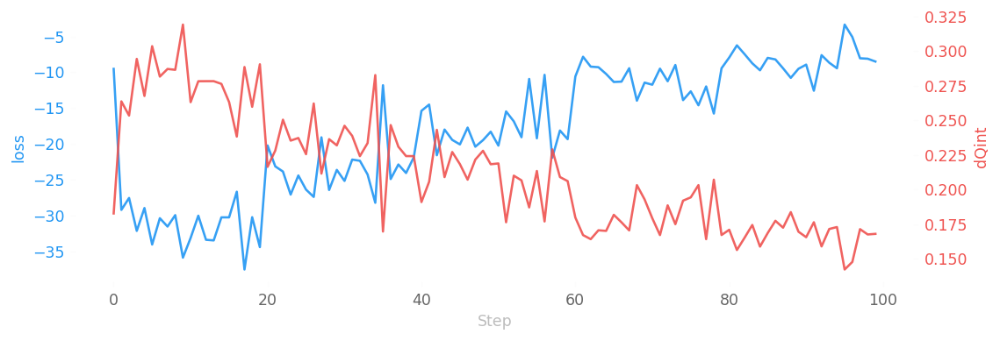

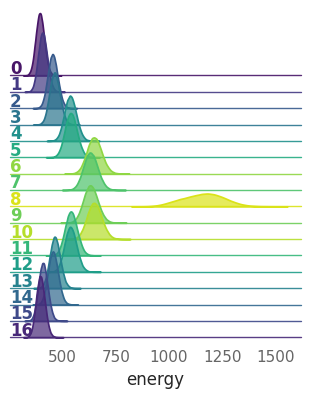

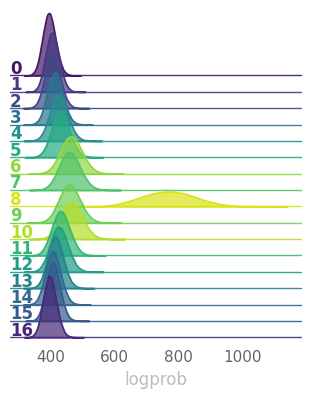

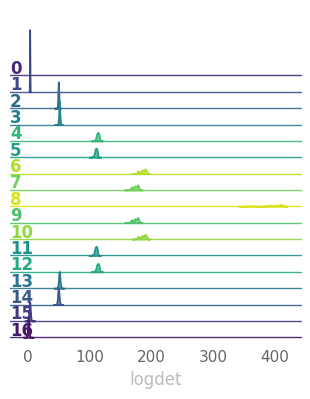

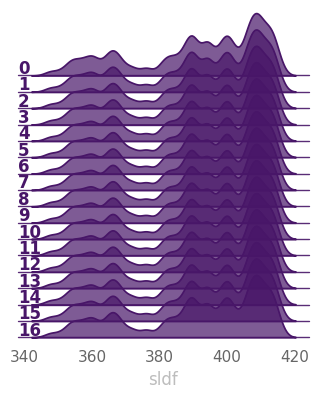

...

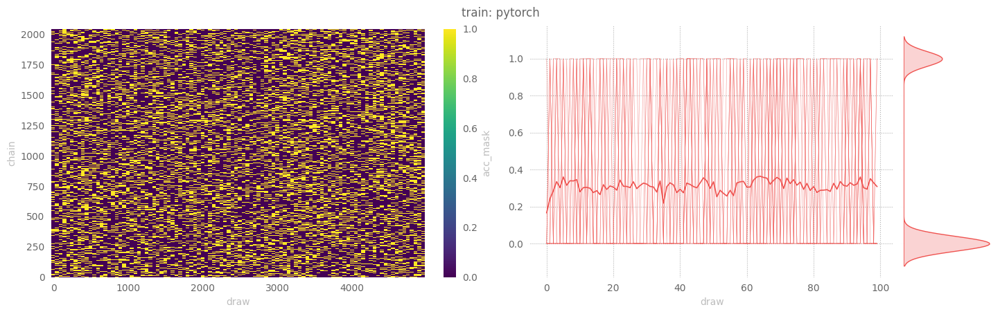

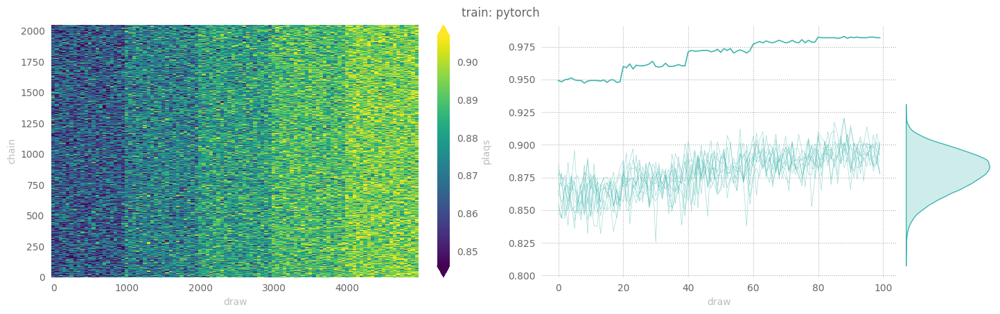

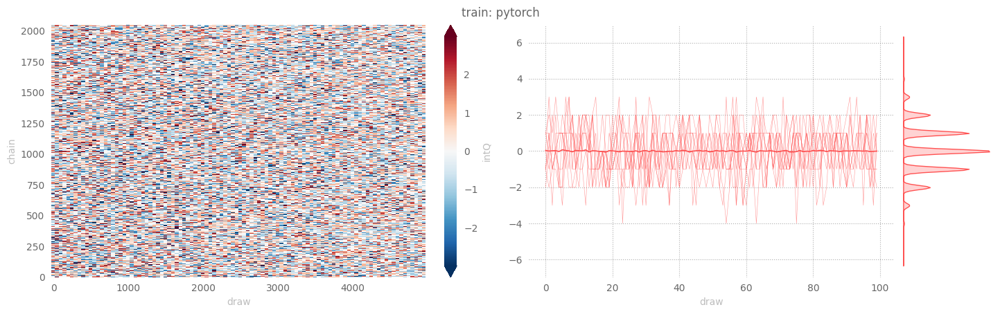

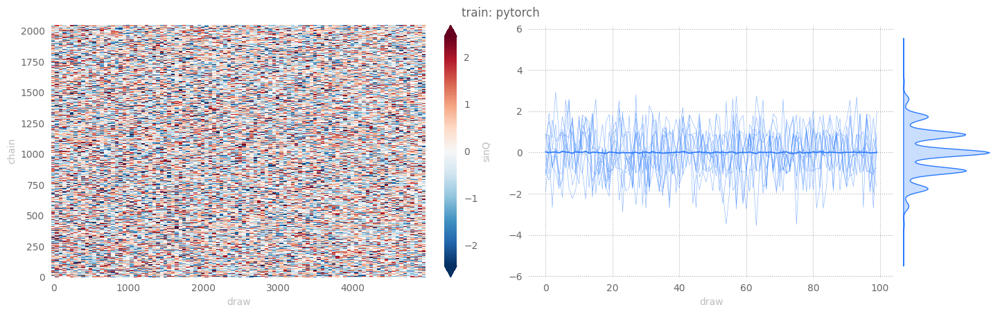

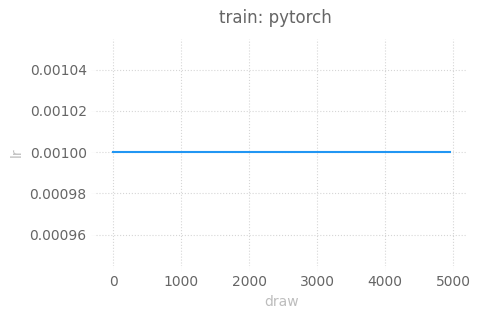

In [8]:
import seaborn as sns
from l2hmc.utils.plot_helpers import set_plot_style

set_plot_style()
sns.set(rc={"figure.dpi":100, 'savefig.dpi':300})
sns.set_context('notebook')
sns.set_style("ticks")
from IPython.display import set_matplotlib_formats
set_matplotlib_formats('retina')

outputs['pytorch']['train'] = ptExpU1.train()

### Inference

#### Evaluation

[23:02:12] WARNING  x.shape (original): torch.Size([2048, 2, 16, 16])

           WARNING  x[:nchains].shape: torch.Size([128, 2, 16, 16])

           INFO     eps=None                                                                 
                    beta=5.0                                                                 
                    nlog=10                                                                  
                    table=<rich.table.Table object at 0x7f984c10cac0>                        
                    nprint=500                                                               
                    eval_steps=2000                                                          
                    nleapfrog=None

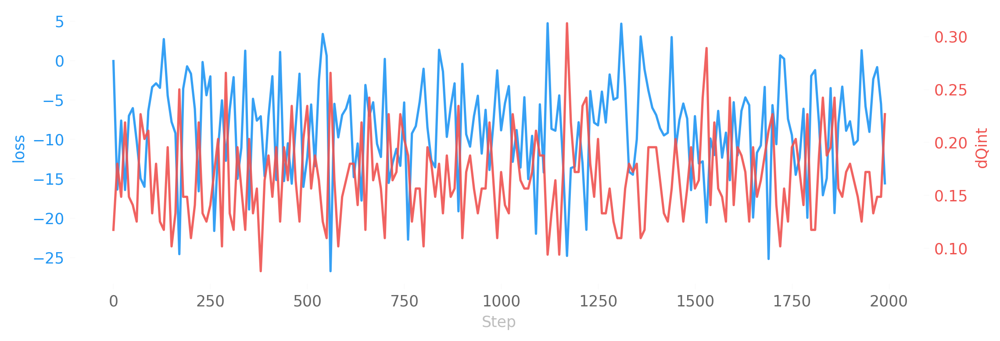

eval:   0%|          | 0/2000 [00:00<?, ?it/s]

[23:02:15] INFO     estep=0   dt=0.1284 beta=5.0000 loss=-0.0769 dQsin=0.1443 dQint=0.1172   
                    energy=547.1533 logprob=448.1513 logdet=99.0019 sldf=359.7148            
                    sldb=-359.7952 sld=99.0019 xeps=0.2017 veps=0.1725 acc=0.2638            
                    sumlogdet=0.0113 acc_mask=0.2891 plaqs=0.8897 intQ=0.1797 sinQ=0.1459

[23:02:17] INFO     estep=500 dt=0.0852 beta=5.0000 loss=-12.3203 dQsin=0.2495 dQint=0.2344  
                    energy=539.2828 logprob=440.1897 logdet=99.0931 sldf=359.7791            
                    sldb=-359.6358 sld=99.0931 xeps=0.2017 veps=0.1725 acc=0.3396            
                    sumlogdet=0.0204 acc_mask=0.3672 plaqs=0.8939 intQ=0.1641 sinQ=0.1311

[23:02:26] INFO     estep=1000 dt=0.0866 beta=5.0000 loss=-8.8717 dQsin=0.1907 dQint=0.1719  
                    energy=540.2974 logprob=441.2984 logdet=98.9989 sldf=359.6931            
                    sldb=-359.8192 sld=98.9989 xeps=0.2017 veps=0.1725 acc=0.3726            
                    sumlogdet=-0.0432 acc_mask=0.3672 plaqs=0.8932 intQ=0.0391 sinQ=0.0514

[23:02:30] INFO     estep=1500 dt=0.0891 beta=5.0000 loss=-7.0701 dQsin=0.1566 dQint=0.1563  
                    energy=540.7820 logprob=441.7650 logdet=99.0170 sldf=359.7423            
                    sldb=-359.8021 sld=99.0170 xeps=0.2017 veps=0.1725 acc=0.3005            
                    sumlogdet=-0.0591 acc_mask=0.2734 plaqs=0.8934 intQ=0.0391 sinQ=0.0335

[23:02:46] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/e
                    val/plots/ridgeplots/svgs/energy_ridgeplot.svg

[23:02:47] INFO     Ridgeplot for energy took 5.110s

[23:02:51] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/e
                    val/plots/ridgeplots/svgs/logprob_ridgeplot.svg

           INFO     Ridgeplot for logprob took 4.525s

[23:02:55] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/e
                    val/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[23:02:56] INFO     Ridgeplot for logdet took 4.601s

[23:02:00] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/e
                    val/plots/ridgeplots/svgs/sldf_ridgeplot.svg

[23:02:01] INFO     Ridgeplot for sldf took 4.574s

[23:02:04] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/e
                    val/plots/ridgeplots/svgs/sldb_ridgeplot.svg

[23:02:05] INFO     Ridgeplot for sldb took 4.560s

[23:02:10] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/e
                    val/plots/ridgeplots/svgs/sld_ridgeplot.svg

[23:02:11] INFO     Ridgeplot for sld took 5.558s

[23:02:23] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/
                    eval/data/eval_data.h5

           INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

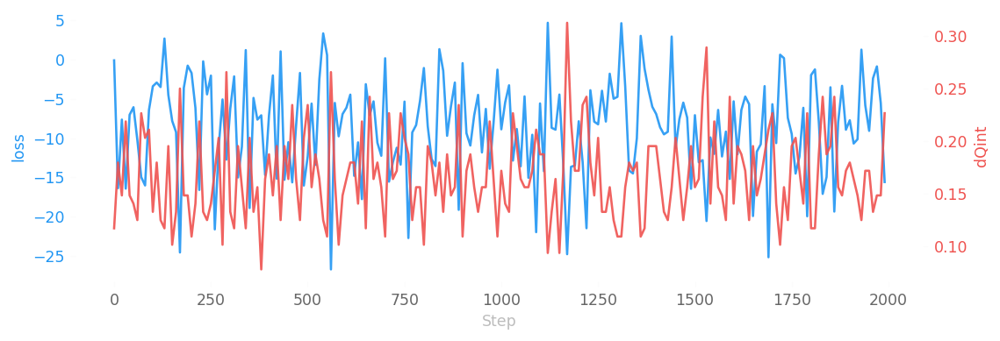

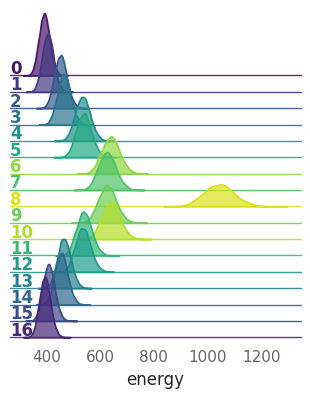

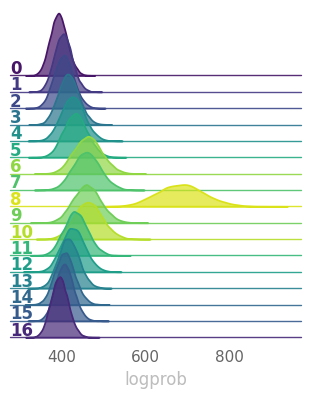

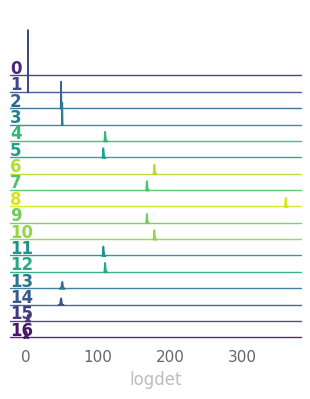

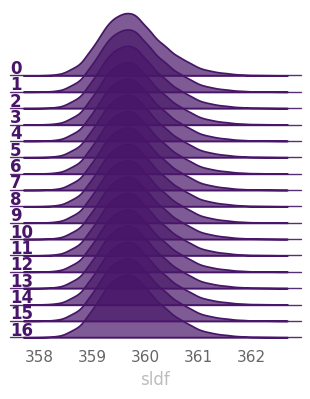

...

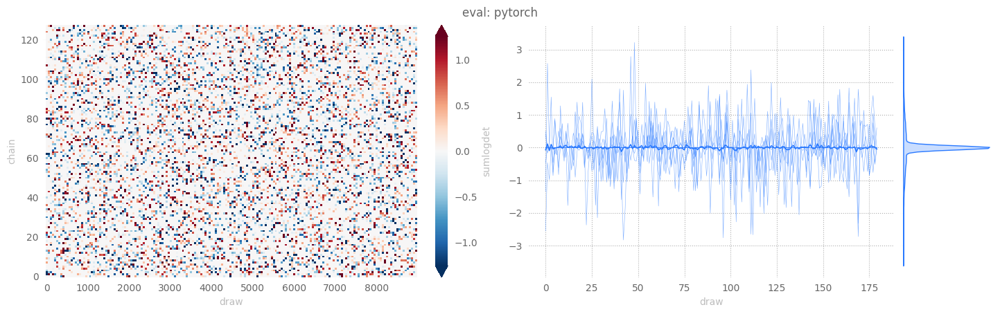

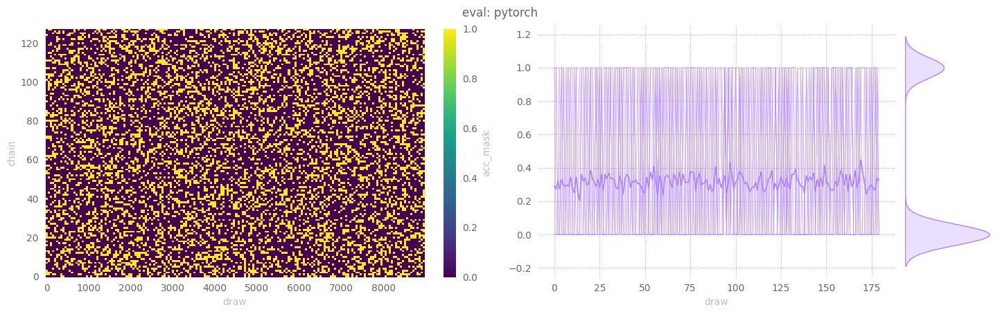

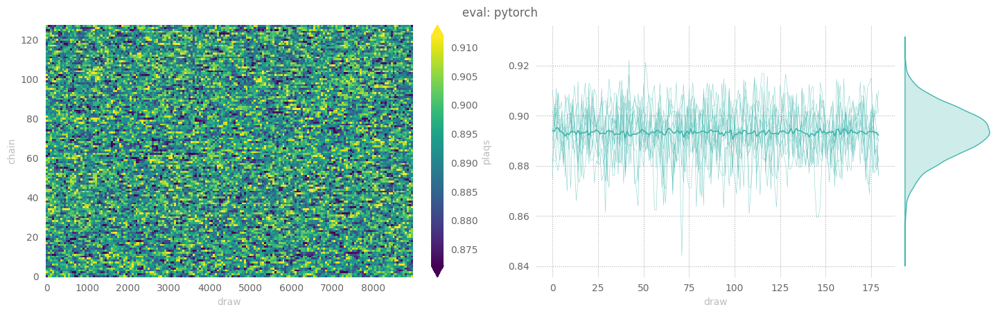

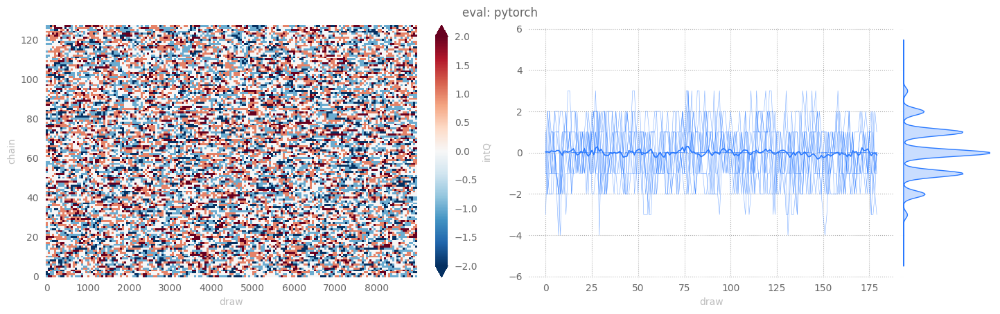

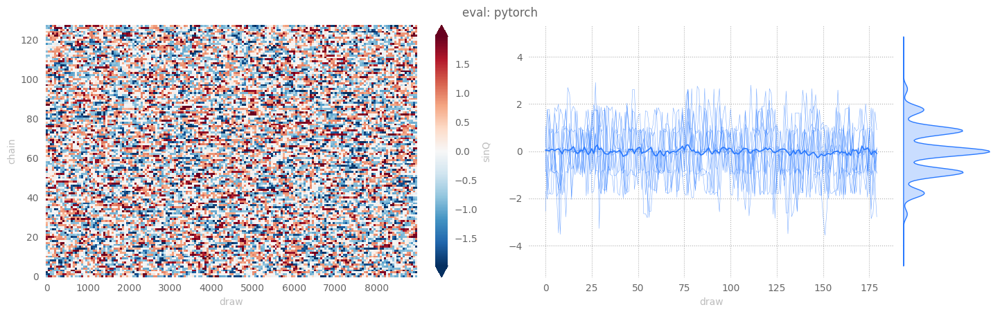

In [9]:
outputs['pytorch']['eval'] = ptExpU1.evaluate(
    job_type='eval',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)

#### HMC

[23:02:31] WARNING  Step size `eps` not specified for HMC! Using default: 0.1250 for generic 
                    HMC

           WARNING  x.shape (original): torch.Size([2048, 2, 16, 16])

           WARNING  x[:nchains].shape: torch.Size([128, 2, 16, 16])

           INFO     eps=0.125                                                                
                    beta=5.0                                                                 
                    nlog=10                                                                  
                    table=<rich.table.Table object at 0x7f984c0eda60>                        
                    nprint=500                                                               
                    eval_steps=2000                                                          
                    nleapfrog=16

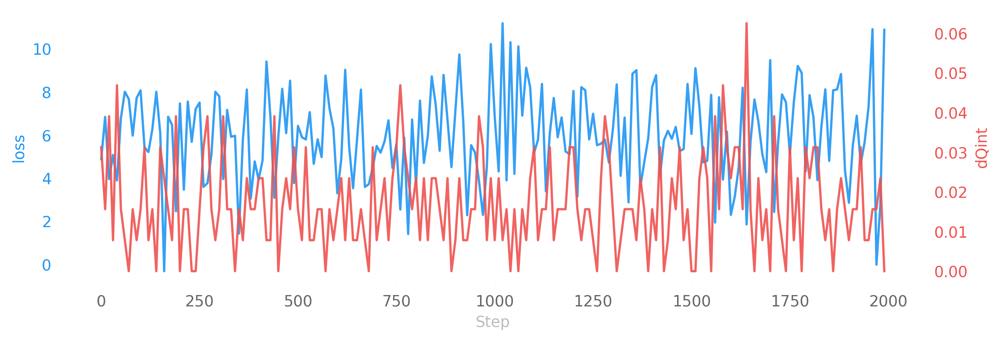

hmc:   0%|          | 0/2000 [00:00<?, ?it/s]

[23:02:34] INFO     hstep=0   dt=0.0270 beta=5.0000 loss=4.8852 dQsin=0.1122 dQint=0.0313    
                    energy=393.6823 logprob=393.6823 logdet=0.0000 acc=0.6214                
                    sumlogdet=0.0000 acc_mask=0.5781 plaqs=0.8922 intQ=0.1563 sinQ=0.1357

[23:02:05] INFO     hstep=500 dt=0.0268 beta=5.0000 loss=6.4289 dQsin=0.1104 dQint=0.0156    
                    energy=393.1586 logprob=393.1586 logdet=0.0000 acc=0.6382                
                    sumlogdet=0.0000 acc_mask=0.6953 plaqs=0.8928 intQ=0.0078 sinQ=0.0077

[23:02:41] INFO     hstep=1000 dt=0.0302 beta=5.0000 loss=6.8394 dQsin=0.0956 dQint=0.0078   
                    energy=389.5076 logprob=389.5076 logdet=0.0000 acc=0.6060                
                    sumlogdet=0.0000 acc_mask=0.5938 plaqs=0.8928 intQ=0.1406 sinQ=0.1294

[23:02:15] INFO     hstep=1500 dt=0.0249 beta=5.0000 loss=6.0533 dQsin=0.0921 dQint=0.0000   
                    energy=392.3747 logprob=392.3747 logdet=0.0000 acc=0.6023                
                    sumlogdet=0.0000 acc_mask=0.6016 plaqs=0.8935 intQ=-0.0156 sinQ=-0.0127

[23:02:52] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/h
                    mc/plots/ridgeplots/svgs/energy_ridgeplot.svg

[23:02:53] INFO     Ridgeplot for energy took 5.388s

[23:02:57] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/h
                    mc/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[23:02:58] INFO     Ridgeplot for logprob took 5.439s

[23:02:01] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/h
                    mc/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[23:02:02] INFO     Ridgeplot for logdet took 4.180s

[23:02:12] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223606/pytorch/
                    hmc/data/hmc_data.h5

           INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

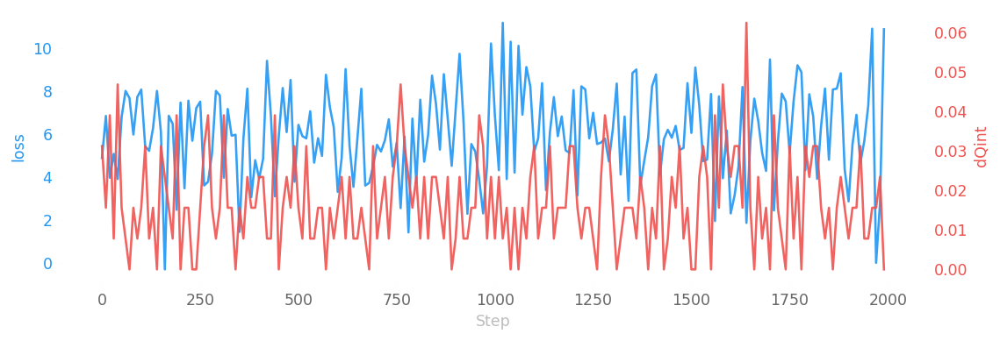

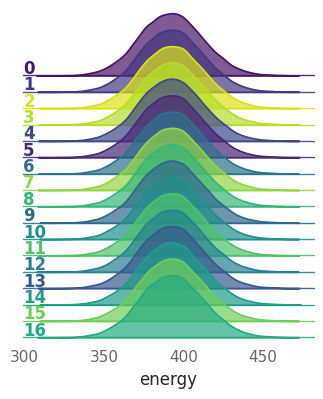

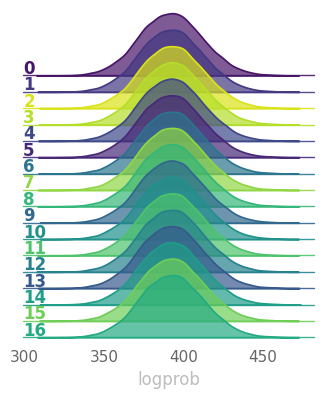

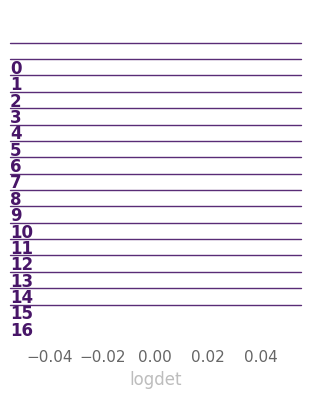

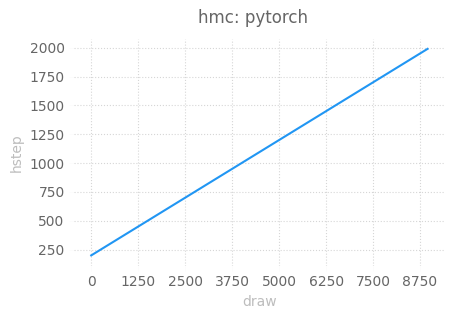

...

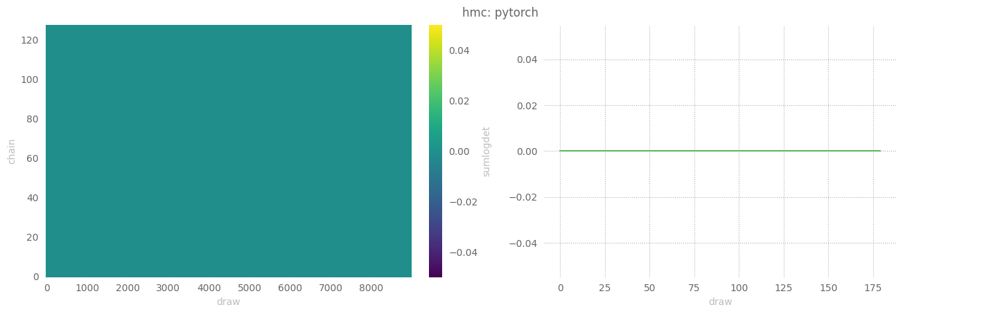

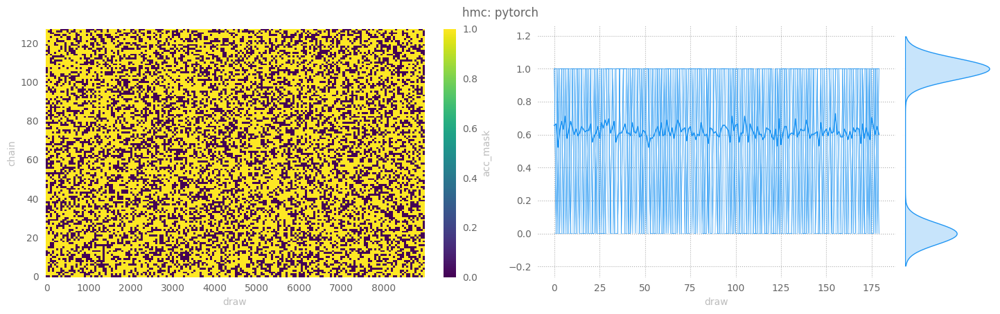

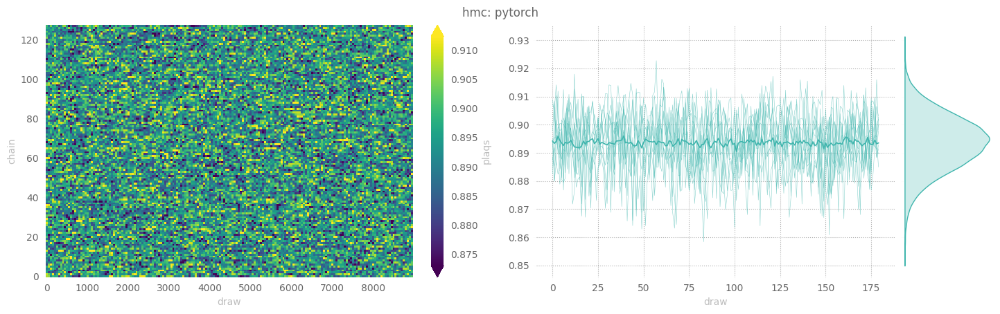

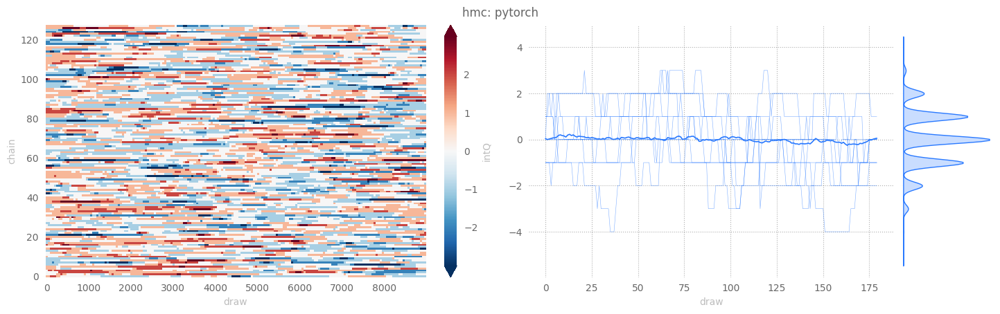

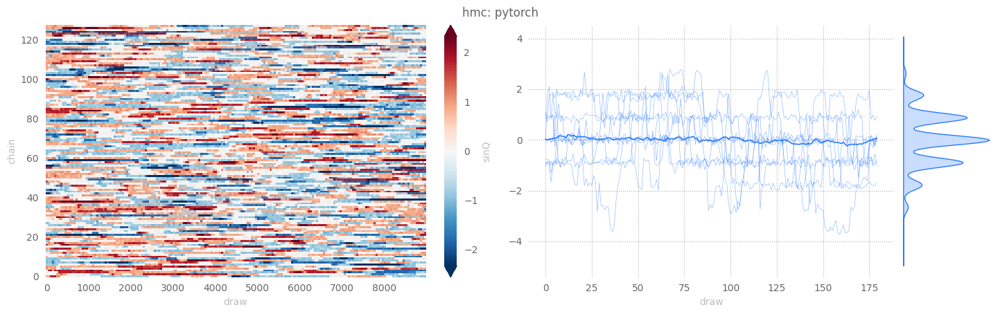

In [10]:
outputs['pytorch']['hmc'] = ptExpU1.evaluate(
    job_type='hmc',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)

## TensorFlow

### Train

[23:02:20] INFO     Looking for checkpoints in: /lus/grand/projects/DLHMC/foremans/locations/
                    thetaGPU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit
                    -True/sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           WARNING  Restored checkpoint from: /lus/grand/projects/DLHMC/foremans/locations/th
                    etaGPU/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-T
                    rue/sepnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow/ckpt-
                    59

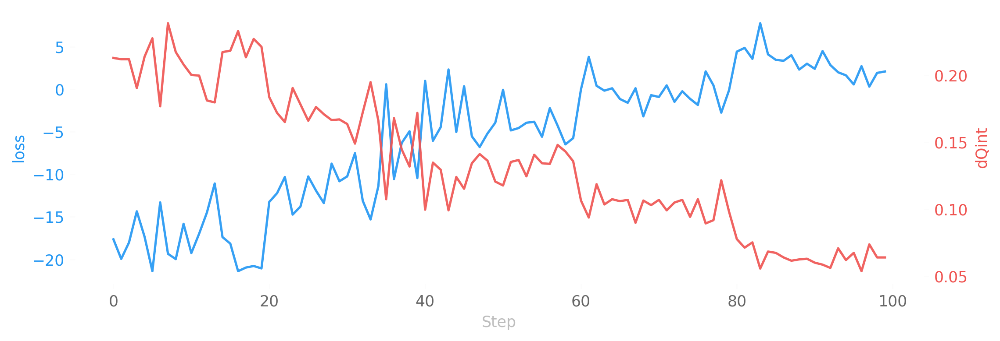

────────────────────────────────── ERA: 0 / 5, BETA: 4.000 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[23:02:59] INFO     era=0   epoch=0   tstep=43501.0000 dt=58.8745 beta=4.0000 loss=-17.6422  
                    dQsin=0.2496 dQint=0.2129 energy=402.8733 logprob=398.6346 logdet=4.2386 
                    sldf=6.6024 sldb=-2.3638 sld=4.2386 xeps=0.1761 veps=0.1534 acc=0.5289   
                    sumlogdet=-0.0010 acc_mask=0.5312 plaqs=0.8633 intQ=0.0405 sinQ=0.0360   
                    lr=0.0010

[23:02:15] INFO     era=0   epoch=500 tstep=44001.0000 dt=0.1218 beta=4.0000 loss=-19.2570   
                    dQsin=0.2241 dQint=0.2002 energy=405.6846 logprob=401.3341 logdet=4.3504 
                    sldf=6.8850 sldb=-2.5346 sld=4.3504 xeps=0.1932 veps=0.1543 acc=0.4306   
                    sumlogdet=0.0023 acc_mask=0.4194 plaqs=0.8639 intQ=0.0098 sinQ=0.0025    
                    lr=0.0010

[23:02:36] INFO     Saving took: 0.419937s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           INFO     Era 0 took: 255.583s

────────────────────────────────── ERA: 1 / 5, BETA: 4.250 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[23:02:12] INFO     era=1   epoch=0   tstep=44501.0000 dt=0.1368 beta=4.2500 loss=-13.2432   
                    dQsin=0.2032 dQint=0.1836 energy=407.0321 logprob=402.4855 logdet=4.5467 
                    sldf=7.2084 sldb=-2.6617 sld=4.5467 xeps=0.2005 veps=0.1565 acc=0.4237   
                    sumlogdet=-0.0010 acc_mask=0.4258 plaqs=0.8727 intQ=-0.0103 sinQ=-0.0024 
                    lr=0.0010

[23:02:26] INFO     era=1   epoch=500 tstep=45001.0000 dt=0.1276 beta=4.2500 loss=-10.2501   
                    dQsin=0.1846 dQint=0.1636 energy=408.1211 logprob=403.4358 logdet=4.6853 
                    sldf=7.3155 sldb=-2.6302 sld=4.6853 xeps=0.2012 veps=0.1496 acc=0.3839   
                    sumlogdet=0.0007 acc_mask=0.3833 plaqs=0.8723 intQ=0.0259 sinQ=0.0205    
                    lr=0.0010

[23:02:40] INFO     Saving took: 0.383961s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           INFO     Era 1 took: 183.797s

           INFO     Avgs over last era:                                                      
                     tstep=44976.0000, dt=0.1292, beta=4.2500, loss=-10.4352, dQsin=0.1919,  
                    dQint=0.1653, energy=407.1534, logprob=402.2922, logdet=4.8612,          
                    sldf=7.5483, sldb=-2.6871, sld=4.8612, xeps=0.1987, veps=0.1546,         
                    acc=0.4004, sumlogdet=0.0001, acc_mask=0.4027, plaqs=0.8724, intQ=0.0026,
                    sinQ=0.0021, lr=0.0010                                                   
           

────────────────────────────────── ERA: 2 / 5, BETA: 4.500 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[23:02:16] INFO     era=2   epoch=0   tstep=45501.0000 dt=0.1331 beta=4.5000 loss=0.9936     
                    dQsin=0.1320 dQint=0.0996 energy=407.7605 logprob=402.4530 logdet=5.3075 
                    sldf=8.1009 sldb=-2.7934 sld=5.3075 xeps=0.2005 veps=0.1533 acc=0.3107   
                    sumlogdet=0.0038 acc_mask=0.3076 plaqs=0.8808 intQ=-0.0049 sinQ=-0.0063  
                    lr=0.0010

[23:02:32] INFO     era=2   epoch=500 tstep=46001.0000 dt=0.1346 beta=4.5000 loss=-0.0743    
                    dQsin=0.1411 dQint=0.1177 energy=408.1847 logprob=403.5545 logdet=4.6301 
                    sldf=7.2208 sldb=-2.5907 sld=4.6301 xeps=0.2018 veps=0.1497 acc=0.3434   
                    sumlogdet=-0.0013 acc_mask=0.3467 plaqs=0.8805 intQ=-0.0293 sinQ=-0.0246 
                    lr=0.0010

[23:02:47] INFO     Saving took: 0.383778s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           INFO     Era 2 took: 187.13s

           INFO     Avgs over last era:                                                      
                     tstep=45976.0000, dt=0.1352, beta=4.5000, loss=-3.7468, dQsin=0.1575,   
                    dQint=0.1292, energy=407.8230, logprob=403.2071, logdet=4.6159,          
                    sldf=7.2022, sldb=-2.5863, sld=4.6159, xeps=0.2012, veps=0.1490,         
                    acc=0.3691, sumlogdet=0.0003, acc_mask=0.3693, plaqs=0.8803, intQ=0.0062,
                    sinQ=0.0058, lr=0.0010                                                   
           

────────────────────────────────── ERA: 3 / 5, BETA: 4.750 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[23:02:23] INFO     era=3   epoch=0   tstep=46501.0000 dt=0.1418 beta=4.7500 loss=-0.0114    
                    dQsin=0.1388 dQint=0.1064 energy=407.4810 logprob=403.3184 logdet=4.1627 
                    sldf=6.6640 sldb=-2.5013 sld=4.1627 xeps=0.2014 veps=0.1469 acc=0.3883   
                    sumlogdet=-0.0047 acc_mask=0.3892 plaqs=0.8875 intQ=-0.0479 sinQ=-0.0424 
                    lr=0.0010

[23:02:39] INFO     era=3   epoch=500 tstep=47001.0000 dt=0.1277 beta=4.7500 loss=-0.9106    
                    dQsin=0.1492 dQint=0.1069 energy=405.5693 logprob=401.6667 logdet=3.9025 
                    sldf=6.2702 sldb=-2.3676 sld=3.9025 xeps=0.1949 veps=0.1451 acc=0.4428   
                    sumlogdet=-0.0002 acc_mask=0.4536 plaqs=0.8876 intQ=-0.0020 sinQ=-0.0018 
                    lr=0.0010

[23:02:52] INFO     Saving took: 0.38457s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           INFO     Era 3 took: 185.061s

           INFO     Avgs over last era:                                                      
                     tstep=46976.0000, dt=0.1291, beta=4.7500, loss=-0.3936, dQsin=0.1419,   
                    dQint=0.1031, energy=406.5832, logprob=402.4346, logdet=4.1486,          
                    sldf=6.5796, sldb=-2.4309, sld=4.1486, xeps=0.1980, veps=0.1456,         
                    acc=0.4178, sumlogdet=-0.0002, acc_mask=0.4170, plaqs=0.8873,            
                    intQ=0.0050, sinQ=0.0039, lr=0.0010                                      
           

────────────────────────────────── ERA: 4 / 5, BETA: 5.000 ──────────────────────────────────

Training:   0%|          | 0/1000 [00:00<?, ?it/s]

[23:02:28] INFO     era=4   epoch=0   tstep=47501.0000 dt=0.1367 beta=5.0000 loss=4.4183     
                    dQsin=0.1185 dQint=0.0776 energy=405.9087 logprob=401.9114 logdet=3.9973 
                    sldf=6.3724 sldb=-2.3751 sld=3.9973 xeps=0.1953 veps=0.1451 acc=0.4061   
                    sumlogdet=0.0016 acc_mask=0.4116 plaqs=0.8931 intQ=-0.0044 sinQ=-0.0057  
                    lr=0.0010

[23:02:41] INFO     era=4   epoch=500 tstep=48001.0000 dt=0.1289 beta=5.0000 loss=2.3995     
                    dQsin=0.1272 dQint=0.0601 energy=401.7086 logprob=397.7755 logdet=3.9332 
                    sldf=6.2633 sldb=-2.3300 sld=3.9332 xeps=0.1823 veps=0.1496 acc=0.5526   
                    sumlogdet=0.0036 acc_mask=0.5498 plaqs=0.8937 intQ=0.0703 sinQ=0.0633    
                    lr=0.0010

[23:02:59] INFO     Saving took: 0.38163s

           INFO     Checkpoint saved to: /lus/grand/projects/DLHMC/foremans/locations/thetaGP
                    U/projects/l2hmc-qcd/src/l2hmc/checkpoints/U1/2-16-16/nlf-8/xsplit-True/s
                    epnets-True/merge-True/net-16-16-16_dp-0.2_bn-False/tensorflow

           INFO     Era 4 took: 187.218s

[23:02:28] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/train/plots/ridgeplots/svgs/energy_ridgeplot.svg

[23:02:29] INFO     Ridgeplot for energy took 30.202s

[23:02:59] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/train/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[23:02:00] INFO     Ridgeplot for logprob took 30.333s

[23:02:27] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/train/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[23:02:28] INFO     Ridgeplot for logdet took 28.055s

[23:02:53] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/train/plots/ridgeplots/svgs/sldf_ridgeplot.svg

[23:02:54] INFO     Ridgeplot for sldf took 26.205s

[23:02:15] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/train/plots/ridgeplots/svgs/sldb_ridgeplot.svg

[23:02:16] INFO     Ridgeplot for sldb took 22.161s

[23:02:43] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/train/plots/ridgeplots/svgs/sld_ridgeplot.svg

[23:02:44] INFO     Ridgeplot for sld took 28.053s

[23:02:03] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorfl
                    ow/train/data/train_data.h5

           INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

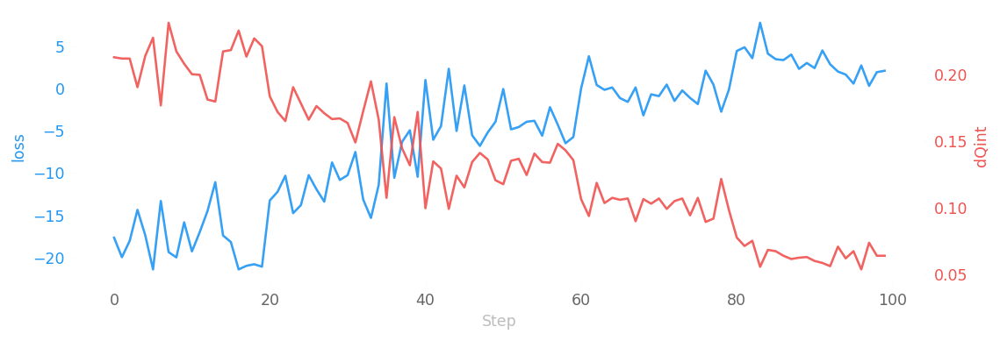

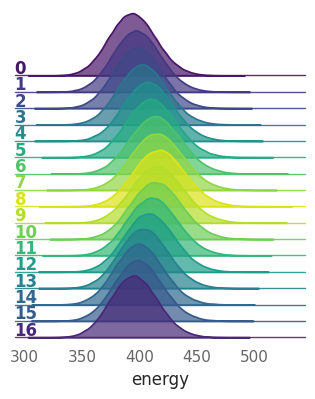

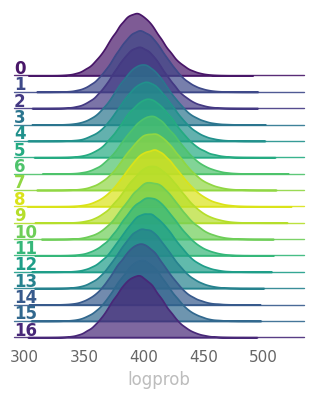

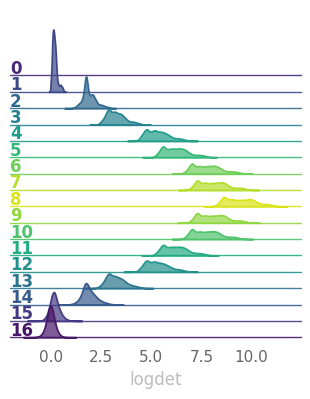

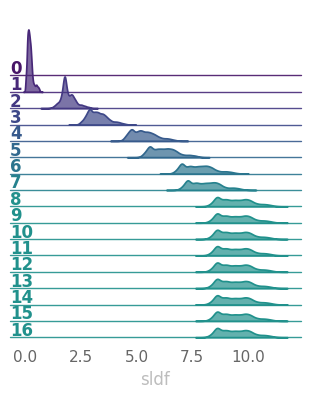

...

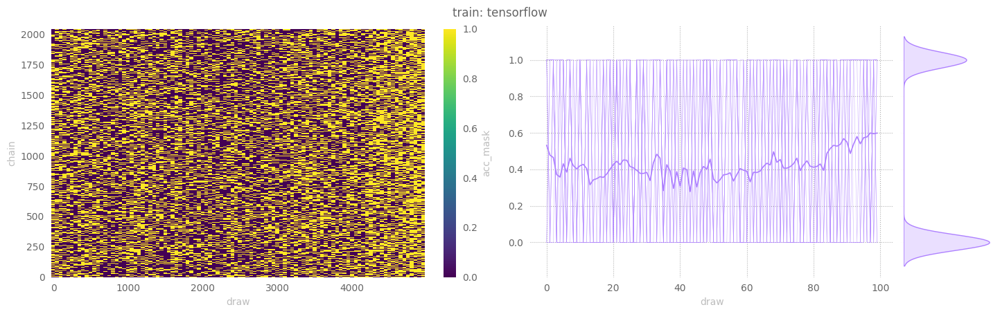

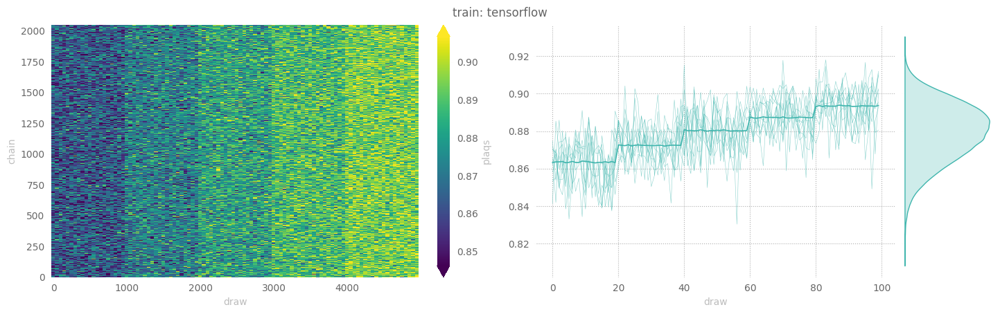

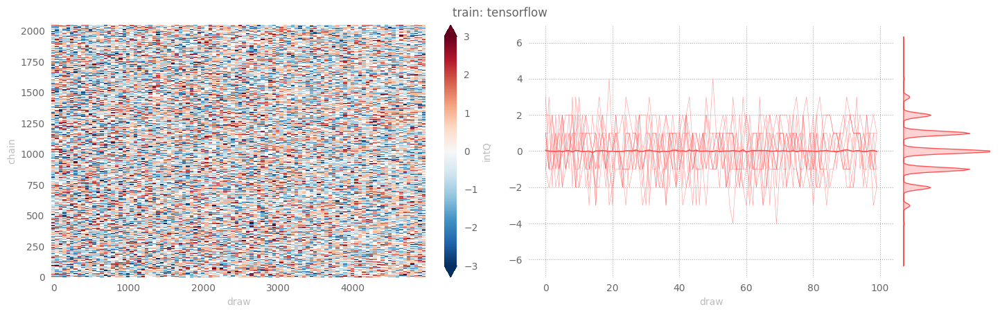

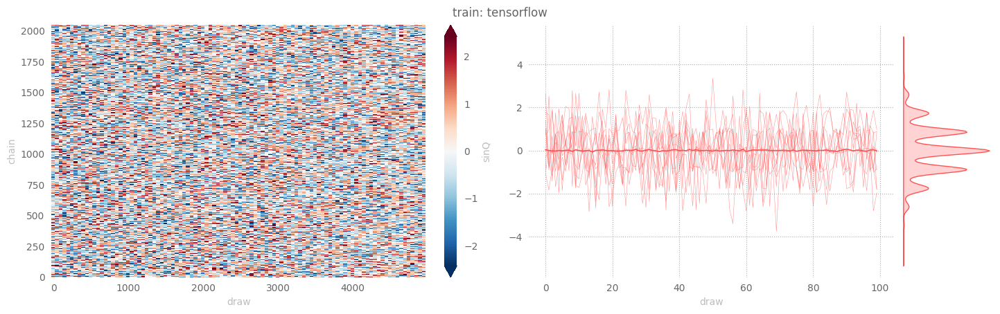

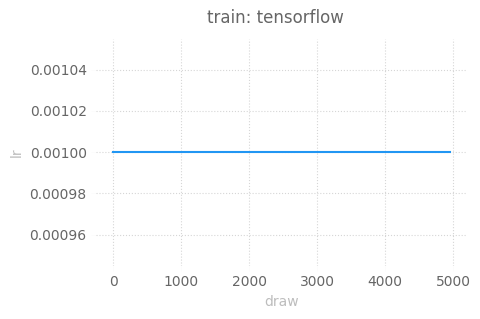

In [11]:
outputs['tensorflow']['train'] = tfExpU1.train()

### Evaluate

[23:02:12] WARNING  x.shape (original): (2048, 2, 16, 16)

           WARNING  x[:nchains].shape: (128, 2, 16, 16)

           INFO     eps = None                                                               
                    beta = 5.0                                                               
                    nlog = 10                                                                
                    table = <rich.table.Table object at 0x7f99143c08e0>                      
                    nprint = 500                                                             
                    eval_steps = 2000                                                        
                    nleapfrog = None

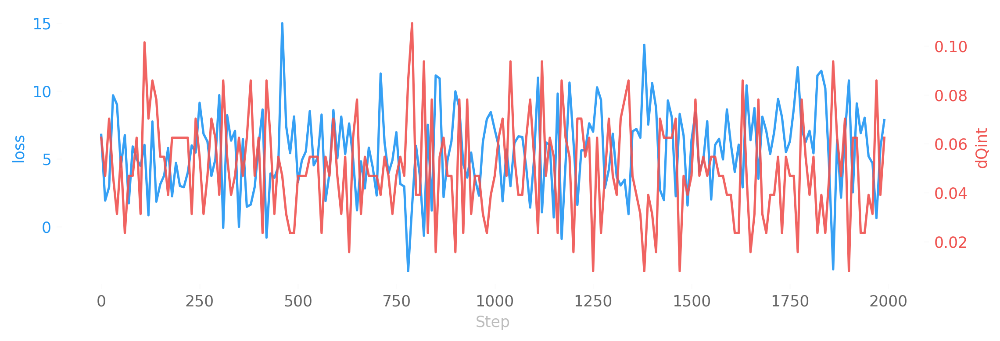

  0%|          | 0/2000 [00:00<?, ?it/s]

[23:02:55] INFO     estep=0   dt=7.3343 beta=5.0000 loss=6.7798 dQsin=0.1347 dQint=0.0625    
                    energy=402.9416 logprob=398.7823 logdet=4.1592 sldf=6.4955 sldb=-2.3363  
                    sld=4.1592 xeps=0.1774 veps=0.1459 acc=0.5186 sumlogdet=0.0032           
                    acc_mask=0.5547 plaqs=0.8929 intQ=-0.1016 sinQ=-0.1001

[23:02:40] INFO     estep=500 dt=0.0331 beta=5.0000 loss=3.2921 dQsin=0.1048 dQint=0.0469    
                    energy=403.9285 logprob=399.7742 logdet=4.1542 sldf=6.4917 sldb=-2.3375  
                    sld=4.1542 xeps=0.1774 veps=0.1459 acc=0.4730 sumlogdet=-0.0059          
                    acc_mask=0.4609 plaqs=0.8919 intQ=0.1328 sinQ=0.0995

[23:02:18] INFO     estep=1000 dt=0.0332 beta=5.0000 loss=7.1663 dQsin=0.0893 dQint=0.0469   
                    energy=404.0494 logprob=399.9041 logdet=4.1452 sldf=6.4812 sldb=-2.3360  
                    sld=4.1452 xeps=0.1774 veps=0.1459 acc=0.4144 sumlogdet=-0.0044          
                    acc_mask=0.4141 plaqs=0.8928 intQ=-0.1250 sinQ=-0.1115

[23:02:57] INFO     estep=1500 dt=0.0322 beta=5.0000 loss=6.3928 dQsin=0.0980 dQint=0.0469   
                    energy=405.4788 logprob=401.3219 logdet=4.1569 sldf=6.4933 sldb=-2.3364  
                    sld=4.1569 xeps=0.1774 veps=0.1459 acc=0.4796 sumlogdet=0.0047           
                    acc_mask=0.5234 plaqs=0.8923 intQ=0.0859 sinQ=0.0996

[23:02:39] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/eval/plots/ridgeplots/svgs/energy_ridgeplot.svg

[23:02:41] INFO     Ridgeplot for energy took 5.069s

[23:02:44] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/eval/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[23:02:45] INFO     Ridgeplot for logprob took 4.895s

[23:02:49] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/eval/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[23:02:50] INFO     Ridgeplot for logdet took 5.061s

[23:02:54] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/eval/plots/ridgeplots/svgs/sldf_ridgeplot.svg

[23:02:55] INFO     Ridgeplot for sldf took 4.864s

[23:02:59] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/eval/plots/ridgeplots/svgs/sldb_ridgeplot.svg

[23:02:00] INFO     Ridgeplot for sldb took 4.535s

[23:02:04] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/eval/plots/ridgeplots/svgs/sld_ridgeplot.svg

[23:02:05] INFO     Ridgeplot for sld took 5.106s

[23:02:19] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorfl
                    ow/eval/data/eval_data.h5

[23:02:20] INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

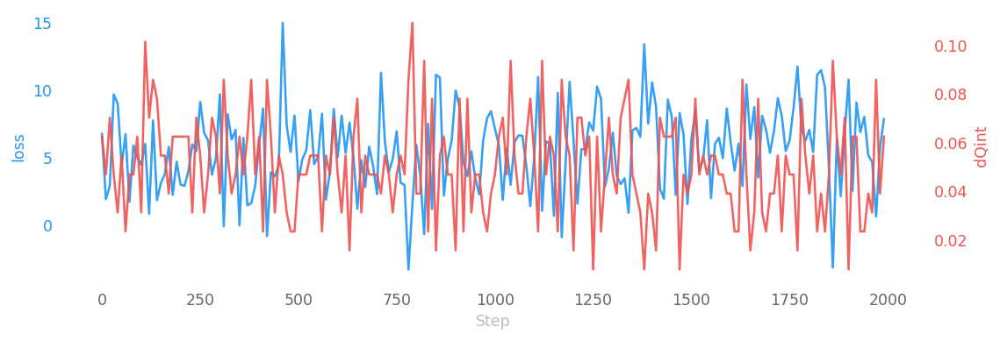

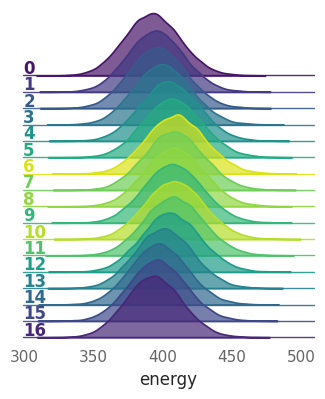

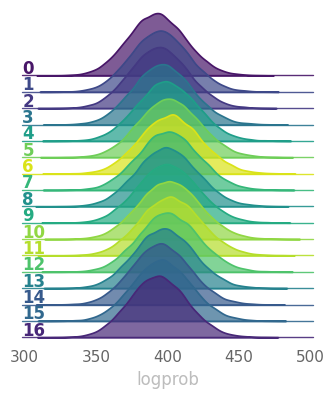

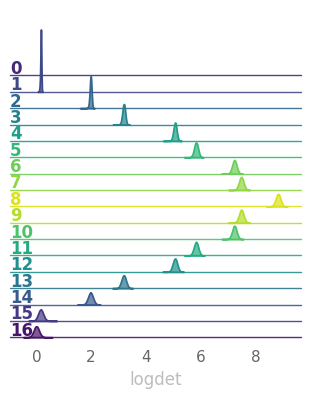

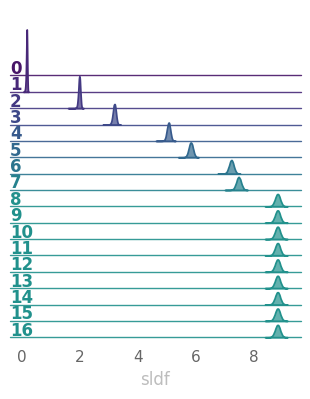

...

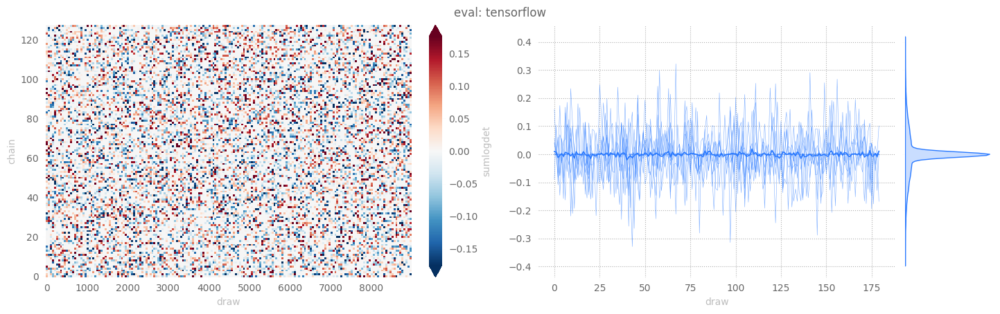

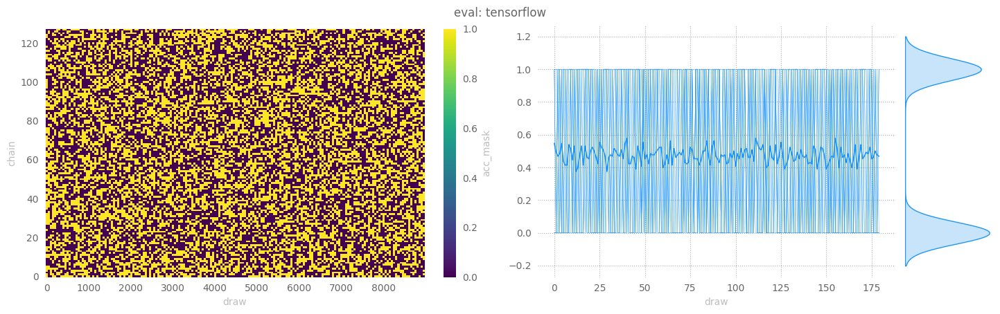

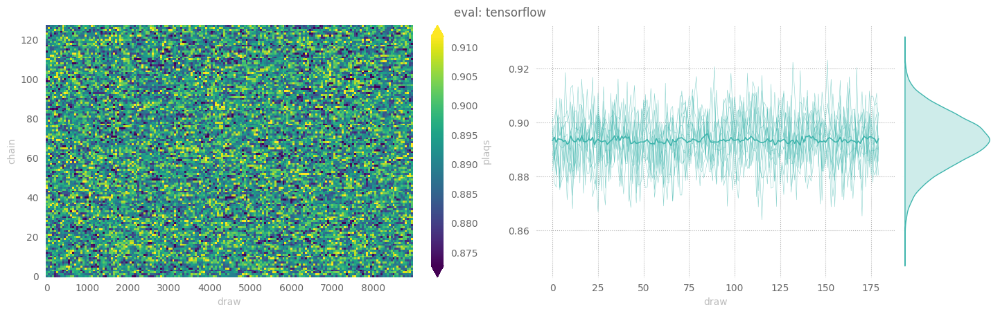

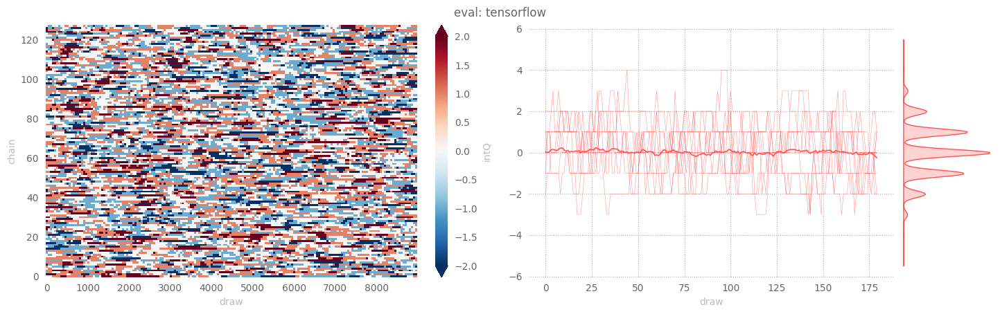

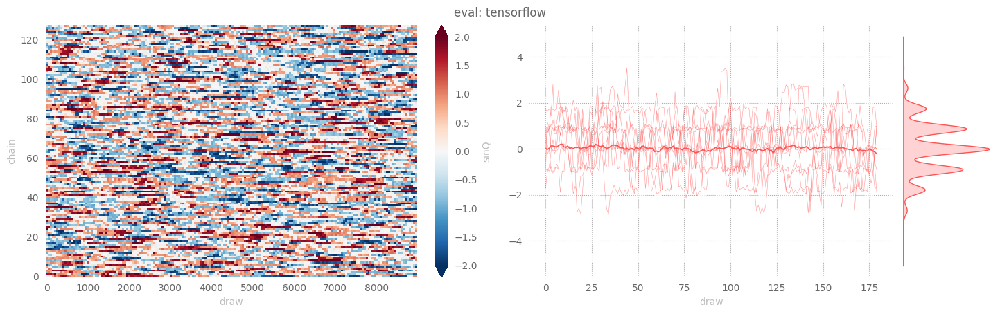

In [12]:
outputs['tensorflow']['eval'] = tfExpU1.evaluate(
    job_type='eval',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)

### HMC

[23:02:29] WARNING  Step size `eps` not specified for HMC! Using default: 0.1250 for generic 
                    HMC

           WARNING  x.shape (original): (2048, 2, 16, 16)

           WARNING  x[:nchains].shape: (128, 2, 16, 16)

           INFO     eps = 0.125                                                              
                    beta = 5.0                                                               
                    nlog = 10                                                                
                    table = <rich.table.Table object at 0x7f92dc60daf0>                      
                    nprint = 500                                                             
                    eval_steps = 2000                                                        
                    nleapfrog = 16

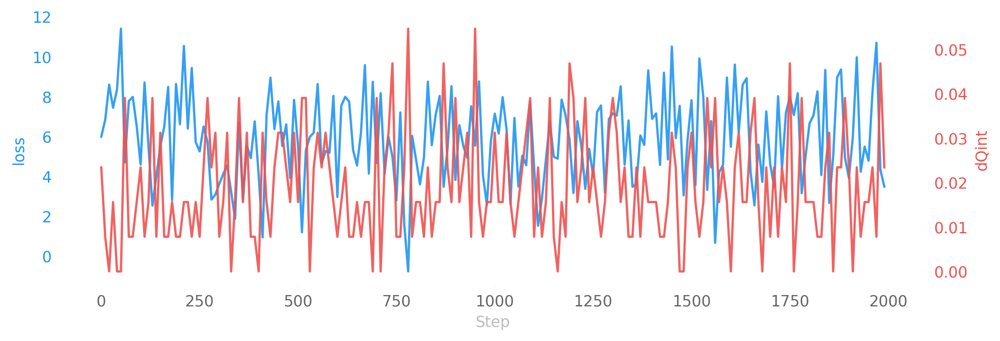

  0%|          | 0/2000 [00:00<?, ?it/s]

[23:02:05] INFO     hstep=0   dt=0.1527 beta=5.0000 loss=5.9930 dQsin=0.1159 dQint=0.0234    
                    energy=394.7720 logprob=394.7720 logdet=0.0000 acc=0.6398                
                    sumlogdet=0.0000 acc_mask=0.6328 plaqs=0.8924 intQ=0.0938 sinQ=0.0919

[23:02:14] INFO     hstep=500 dt=0.0986 beta=5.0000 loss=5.5666 dQsin=0.1087 dQint=0.0156    
                    energy=393.6672 logprob=393.6672 logdet=0.0000 acc=0.6202                
                    sumlogdet=0.0000 acc_mask=0.6875 plaqs=0.8924 intQ=-0.1484 sinQ=-0.1282

[23:02:24] INFO     hstep=1000 dt=0.0986 beta=5.0000 loss=7.1450 dQsin=0.0992 dQint=0.0313   
                    energy=393.2174 logprob=393.2174 logdet=0.0000 acc=0.6142                
                    sumlogdet=0.0000 acc_mask=0.6016 plaqs=0.8941 intQ=-0.1563 sinQ=-0.1455

[23:02:34] INFO     hstep=1500 dt=0.0976 beta=5.0000 loss=7.8203 dQsin=0.1116 dQint=0.0313   
                    energy=390.8486 logprob=390.8486 logdet=0.0000 acc=0.6142                
                    sumlogdet=0.0000 acc_mask=0.6406 plaqs=0.8942 intQ=0.0547 sinQ=0.0571

[23:02:50] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/hmc/plots/ridgeplots/svgs/energy_ridgeplot.svg

[23:02:51] INFO     Ridgeplot for energy took 4.977s

[23:02:55] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/hmc/plots/ridgeplots/svgs/logprob_ridgeplot.svg

[23:02:56] INFO     Ridgeplot for logprob took 5.045s

[23:02:59] WARNING  Saving figure to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/p
                    rojects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorflo
                    w/hmc/plots/ridgeplots/svgs/logdet_ridgeplot.svg

[23:02:00] INFO     Ridgeplot for logdet took 4.030s

[23:02:10] INFO     Saving dataset to: /lus/grand/projects/DLHMC/foremans/locations/thetaGPU/
                    projects/l2hmc-qcd/src/l2hmc/notebooks/outputs/2023-02-14-223630/tensorfl
                    ow/hmc/data/hmc_data.h5

           INFO     Done saving and analyzing data.

           INFO     Creating summaries for WandB, Aim

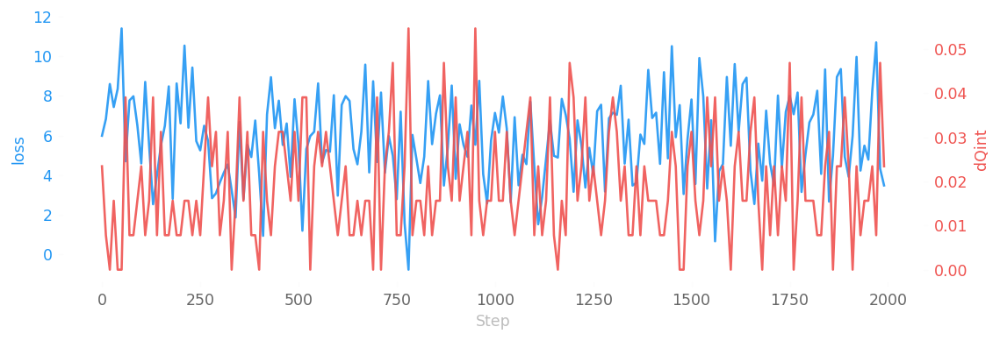

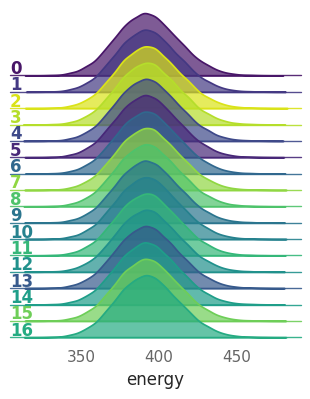

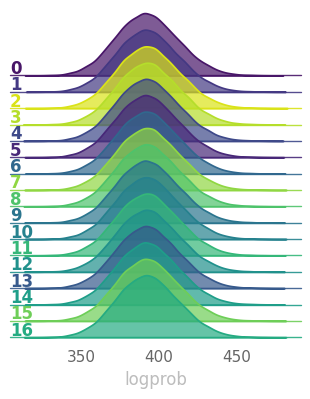

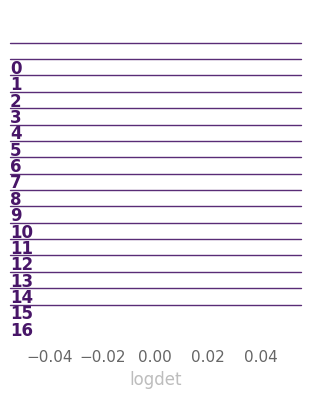

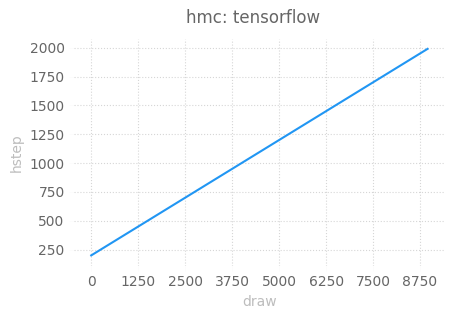

...

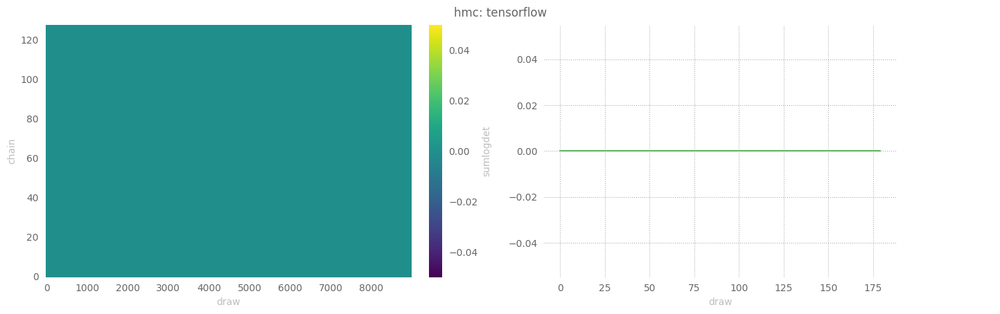

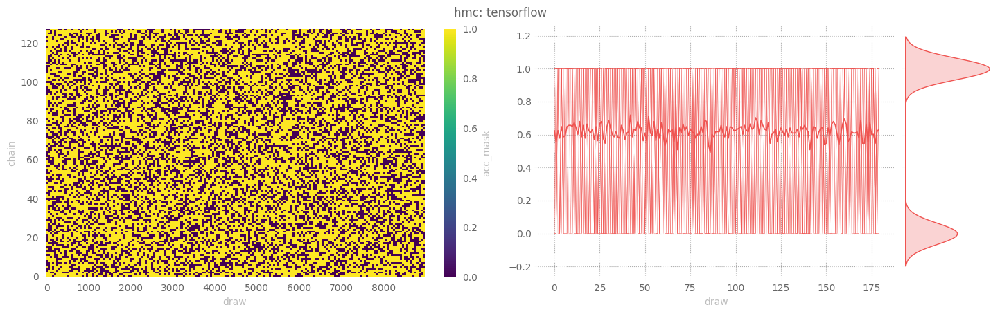

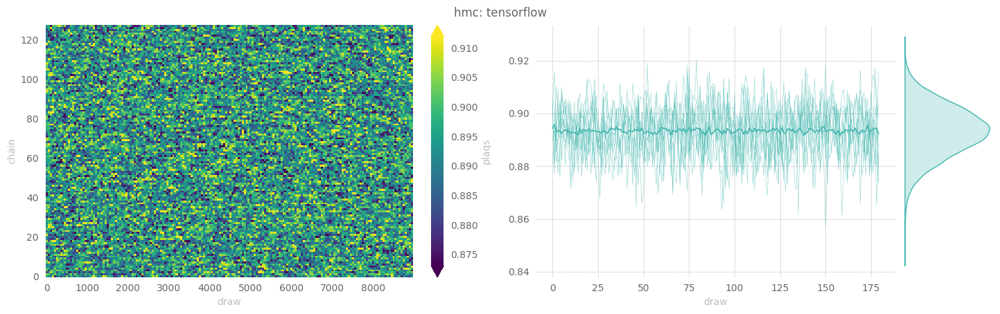

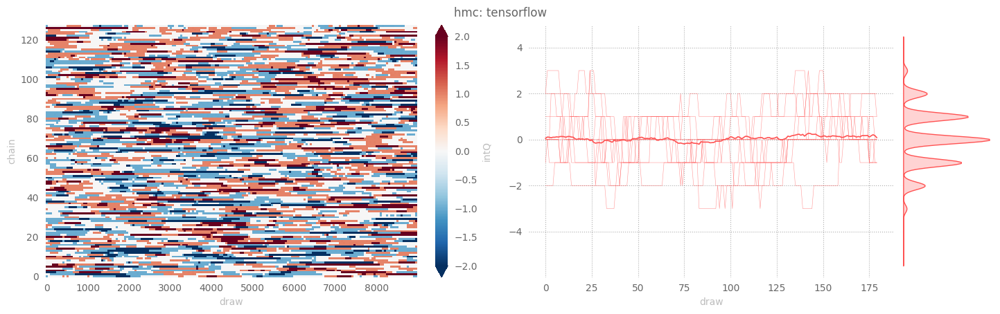

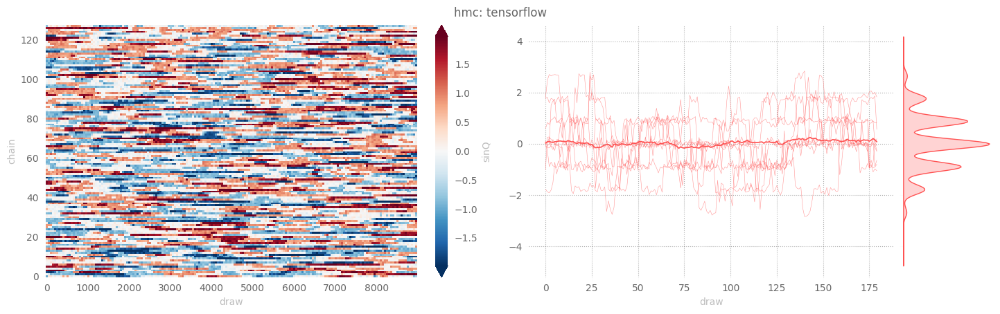

In [13]:
outputs['tensorflow']['hmc'] = tfExpU1.evaluate(
    job_type='hmc',
    nprint=500,
    nchains=128,
    eval_steps=2000,
)

# Model Performance

Our goal is improving the efficiency of our MCMC sampler.

In particular, we are interested in generating **independent** configurations which we can then use to calculate expectation values of physical observables.

For our purposes, we are interested in obtaining lattice configurations from distinct _topological charge sectors_, as characterized by a configurations _topological charge_, $Q$.

HMC is known to suffer from _critical slowing down_, a phenomenon in which our configurations remains stuck in some local topological charge sector and fails to produce distinct configurations.

In particular, it is known that the integrated autocorrelation time of the topological charge $\tau$ grows exponentially with decreasing lattice spacing (i.e. continuum limit), making this theory especially problematic.

Because of this, we can assess our models' performance by looking at the _tunneling rate_, i.e. the rate at which our sampler jumps between these different charge sectors.

We can write this quantity as:

$$
\delta Q = |Q^{(i)} - Q^{(i-1)}|
$$

where we look at the difference in the topological charge between sequential configurations.

<div class="alert alert-block alert-info" style="background:rgba(34,139,230,0.1); color: rgb(34,139,230); border: 0px solid; border-radius:5px;">
<b>Note:</b> 
The efficiency of our sampler is directly proportional to the tunneling rate, which is inversely proportional to the integrated autocorrelation time $\tau$, i.e.

&nbsp;

$$
\text{Efficiency} \propto \delta Q \propto \frac{1}{\tau}
$$

Explicitly, this means that the **more efficient** the model $\longrightarrow$

- the **larger** tunneling rate
- the **smaller** integrated autocorrelation time for $Q$
</div>

In [14]:
import xarray as xr

def get_thermalized_configs(
        x: np.ndarray | xr.DataArray,
        drop: int = 5
) -> np.ndarray | xr.DataArray:
    if isinstance(x, np.ndarray):
        return np.sort(x)[..., :-drop]
    if isinstance(x, xr.DataArray):
        return x.sortby(
            ['chain', 'draw'],
            ascending=False
        )[..., :-drop]
    raise TypeError

# Comparisons

We can measure our models' performance explicitly by looking at the average tunneling rate, $\delta Q_{\mathbb{Z}}$, for our **trained model** and comparing it against generic HMC.

Recall,

$$\delta Q_{\mathbb{Z}} := \big|Q^{(i+1)}_{\mathbb{Z}} - Q^{(i)}_{\mathbb{Z}}\big|$$

where a **higher** value of $\delta Q_{\mathbb{Z}}$ corresponds to **better** tunneling of the topological charge, $Q_{\mathbb{Z}}$.

Note that we can get a concise representation of the data from different parts of our run via:

Note that the data from each of the different parts of our experiment (i.e. `train`, `eval`, and `hmc`) are stored as a dict, e.g.

```python
>>> list(ptExpU1.trainer.histories.keys())
['train', 'eval', 'hmc']
>>> train_history = ptExpU1.trainer.histories['train']
>>> train_dset = train_history.get_dataset()
>>> assert isinstance(train_history, l2hmc.utils.history.BaseHistory)
>>> assert isinstance(train_dset, xarray.Dataset)
```

(see below, for example)

We aggregate the data into the `dsets` dict below, grouped by:

1. **Framework** (`pytorch` / `tensorflow`)
2. **Job type** (`train`, `eval`, `hmc`)

In [15]:
import logging
log = logging.getLogger(__name__)
dsets = {}
fws = ['pt', 'tf']
modes = ['train', 'eval', 'hmc']
for fw in fws:
    dsets[fw] = {}
    for mode in modes:
        hist = None
        if fw == 'pt':
            hist = ptExpU1.trainer.histories.get(mode, None)
        elif fw == 'tf':
            hist = tfExpU1.trainer.histories.get(mode, None)
        if hist is not None:
            log.info(f'Getting dataset for {fw}: {mode}')
            dsets[fw][mode] = hist.get_dataset()

[23:02:17] INFO     Getting dataset for pt: train

           INFO     Getting dataset for pt: eval

           INFO     Getting dataset for pt: hmc

           INFO     Getting dataset for tf: train

           INFO     Getting dataset for tf: eval

           INFO     Getting dataset for tf: hmc

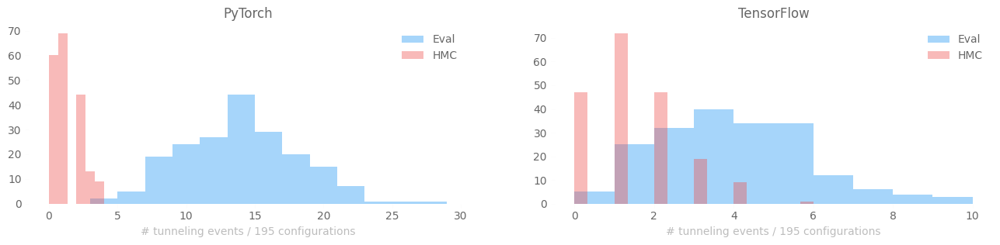

In [16]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['text.usetex'] = False
import matplotlib.pyplot as plt
from l2hmc.utils.plot_helpers import COLORS, set_plot_style

set_plot_style()

fig, ax = plt.subplots(figsize=(16, 3), ncols=2)

# ---------------------------------------------
# ---- DROP FIRST 20% FOR THERMALIZATION ------
# ---------------------------------------------
KEEP = int(0.8 * len(dsets['tf']['eval'].draw))
dqpte = get_thermalized_configs(dsets['pt']['eval']['dQint'].astype('int'))
dqpth = get_thermalized_configs(dsets['pt']['hmc']['dQint'].astype('int'))

dqtfe = get_thermalized_configs(dsets['tf']['eval']['dQint'].astype('int'))
dqtfh = get_thermalized_configs(dsets['tf']['hmc']['dQint'].astype('int'))

_ = sns.distplot(
    dqpte.sum('chain'),
    kde=False,
    color=COLORS['blue'],
    label='Eval',
    ax=ax[0]
)
_ = sns.distplot(
    dqpth.sum('chain'),
    kde=False,
    color=COLORS['red'],
    label='HMC',
    ax=ax[0]
)

_ = ax[0].set_title('PyTorch')
_ = ax[0].set_xlabel(
    f'# tunneling events / {dqpte.shape[-1]} configurations'
)
_ = ax[0].legend(loc='best', frameon=False)
plt.legend()

_ = sns.distplot(
    dqtfe.sum('chain'),
    kde=False,
    color=COLORS['blue'],
    label='Eval',
    ax=ax[1]
)
_ = sns.distplot(
    dqtfh.sum('chain'),
    kde=False,
    color=COLORS['red'],
    label='HMC',
    ax=ax[1]
)

_ = ax[1].set_title('TensorFlow')
_ = ax[1].set_xlabel(
    #r"""$\sum_{i=0} \left|\delta Q_{i}\right|$""",
    #fontsize='large',
    f'# tunneling events / {dqpte.shape[-1]} configurations'
)
_ = ax[1].legend(loc='best', frameon=False)

## TensorFlow Results

In [17]:
import rich

[23:02:18] INFO     TensorFlow, EVAL                                                         
                     dQint.sum('chain'):                                                     
                     <xarray.DataArray 'dQint' (draw: 90)>                                   
                    array([3, 1, 8, 3, 4, 2, 1, 5, 3, 4, 2, 4, 7, 4, 5, 1, 5, 1, 2, 4, 2, 3, 
                           4, 9, 4, 4, 4, 0, 0, 3, 2, 1, 6, 4, 5, 5, 5, 1, 2, 1, 4, 3, 4, 5, 
                           4, 5, 4, 3, 5, 3, 2, 3, 1, 6, 2, 1, 1, 6, 1, 2, 3, 3, 3, 1, 3, 1, 
                           4, 1, 1, 4, 2, 4, 2, 1, 3, 5, 5, 6, 5, 7, 0, 2, 4, 2, 3, 1, 2, 6, 
                           3, 3])                                                            
                    Coordinates:                                                             
                      * draw     (draw) int64 110 111 112 113 114 115 ... 194 195 196 197 198
                    199

           INFO     dQint.sum(): <xarray.DataArray 'dQint' ()>                               
                    array(289)

           INFO     TensorFlow, HMC                                                          
                     dQint.sum('chain'):                                                     
                     <xarray.DataArray 'dQint' (draw: 90)>                                   
                    array([1, 1, 0, 2, 3, 0, 0, 1, 1, 2, 2, 2, 2, 2, 1, 2, 1, 0, 0, 4, 4, 2, 
                           1, 2, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 2, 3, 2, 0, 0, 2, 1, 2, 0, 2, 
                           3, 2, 4, 0, 1, 0, 0, 0, 4, 1, 1, 3, 3, 2, 0, 3, 1, 3, 1, 2, 1, 2, 
                           0, 1, 3, 2, 1, 1, 0, 0, 3, 4, 0, 1, 2, 1, 1, 0, 2, 1, 2, 2, 3, 1, 
                           2, 2])                                                            
                    Coordinates:                                                             
                      * draw     (draw) int64 110 111 112 113 114 115 ... 194 195 196 197 198
                    199

           INFO     dQint.sum(): <xarray.DataArray 'dQint' ()>                               
                    array(129)

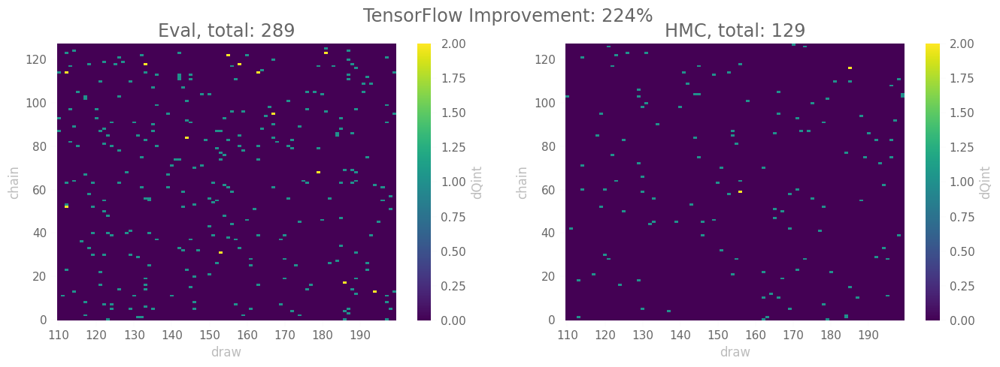

In [18]:
sns.set_context('notebook')
ndraws = len(dsets['tf']['eval']['dQint'].draw)
drop = int(0.1 * ndraws)
keep = int(0.9 * ndraws)

dqe = dsets['tf']['eval']['dQint'][:, -90:]
dqh = dsets['tf']['hmc']['dQint'][:, -90:]

etot = dqe.astype(int).sum()
htot = dqh.astype(int).sum()

fsize = plt.rcParams['figure.figsize']
figsize = (2.5 * fsize[0], fsize[1])
fig, ax = plt.subplots(figsize=figsize, ncols=2)
_ = dqe.astype(int).plot(ax=ax[0])
_ = dqh.astype(int).plot(ax=ax[1])
_ = ax[0].set_title(f'Eval, total: {etot.values}', fontsize='x-large');
_ = ax[1].set_title(f'HMC, total: {htot.values}', fontsize='x-large');
_ = fig.suptitle(fr'TensorFlow Improvement: {100*(etot / htot):3.0f}%', fontsize='x-large')

log.info(f"TensorFlow, EVAL\n dQint.sum('chain'):\n {dqe.astype(int).sum('chain').T}")
log.info(f"dQint.sum(): {dqe.astype(int).sum().T}")
log.info(f"TensorFlow, HMC\n dQint.sum('chain'):\n {dqh.astype(int).sum('chain').T}")
log.info(f"dQint.sum(): {dqh.astype(int).sum().T}")

### PyTorch Results

[23:02:19] INFO     PyTorch, EVAL                                                            
                     dQint.sum('chain'):                                                     
                     [18 19  5 11 13  9 12 24 22 17 14 25 16 18  8 19  7 12 11 12  7 10 10 16
                     13 14  8 10 11 16 17 13 14 10 14 15 13 15 14 17 15 13 18 29 11 12 15 11 
                     13 18 13 12 17 17 13 16 14 11 16 19 18 10  8 12  5 14 16 14  9 19  9  3 
                     14 22 12 12 15 16  9 15 14 14 12 10 15 16 12 11  9 19]

           INFO     dQint.sum(): 1236

           INFO     PyTorch, HMC                                                             
                     dQint.sum('chain'):                                                     
                     [2 1 1 1 3 0 2 1 1 2 1 2 1 1 1 0 0 2 2 3 2 0 1 0 1 1 0 2 1 0 1 0 4 0 0 1
                    1                                                                        
                     2 1 2 0 0 2 3 2 0 4 0 3 2 2 3 2 1 4 1 0 1 1 1 0 4 0 0 0 1 1 0 0 3 1 3 1 
                    2                                                                        
                     1 1 0 1 1 1 1 1 2 4 0 0 2 1 2 0]

           INFO     dQint.sum(): 113

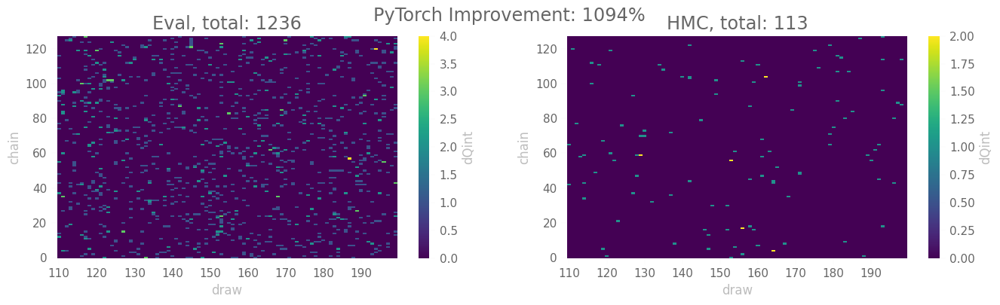

In [19]:
sns.set_context('notebook')
ndraws = len(dsets['pt']['eval']['dQint'].draw)
drop = int(0.1 * ndraws)
keep = int(0.9 * ndraws)

dqe = dsets['pt']['eval']['dQint'][:, -90:]
dqh = dsets['pt']['hmc']['dQint'][:, -90:]

etot = dqe.astype(int).sum()
htot = dqh.astype(int).sum()

fsize = plt.rcParams['figure.figsize']
figsize = (2.5 * fsize[0], 0.8 * fsize[1])
fig, ax = plt.subplots(figsize=figsize, ncols=2)
_ = dqe.astype(int).plot(ax=ax[0])
_ = dqh.astype(int).plot(ax=ax[1])
_ = ax[0].set_title(f'Eval, total: {etot.values}', fontsize='x-large');
_ = ax[1].set_title(f'HMC, total: {htot.values}', fontsize='x-large');
_ = fig.suptitle(fr'PyTorch Improvement: {100*(etot / htot):3.0f}%', fontsize='x-large')

log.info(f"PyTorch, EVAL\n dQint.sum('chain'):\n {dqe.astype(int).sum('chain').T.values}")
log.info(f"dQint.sum(): {dqe.astype(int).sum().T.values}")
log.info(f"PyTorch, HMC\n dQint.sum('chain'):\n {dqh.astype(int).sum('chain').T.values}")
log.info(f"dQint.sum(): {dqh.astype(int).sum().T.values}")

## Comparisons

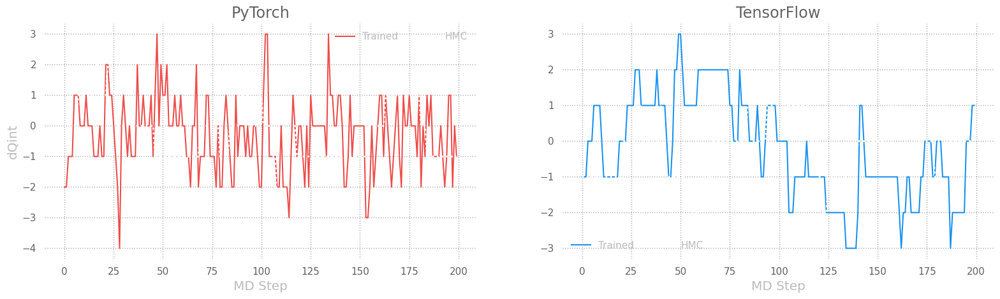

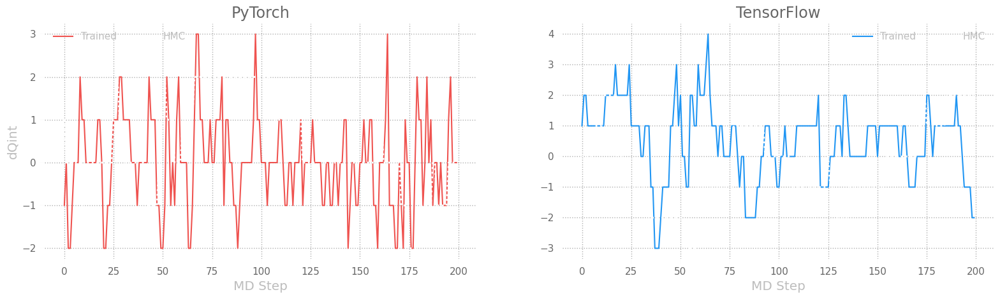

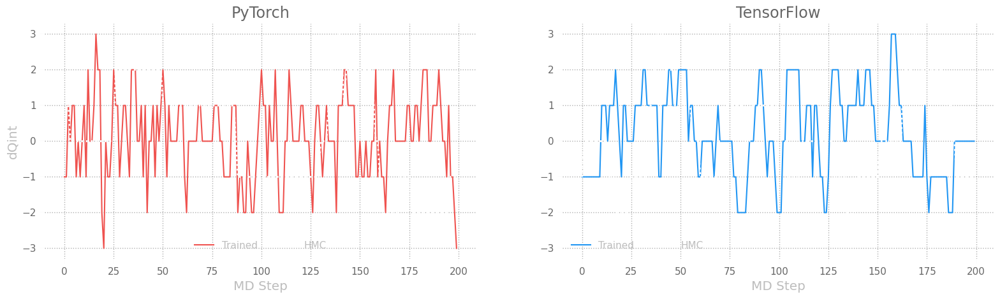

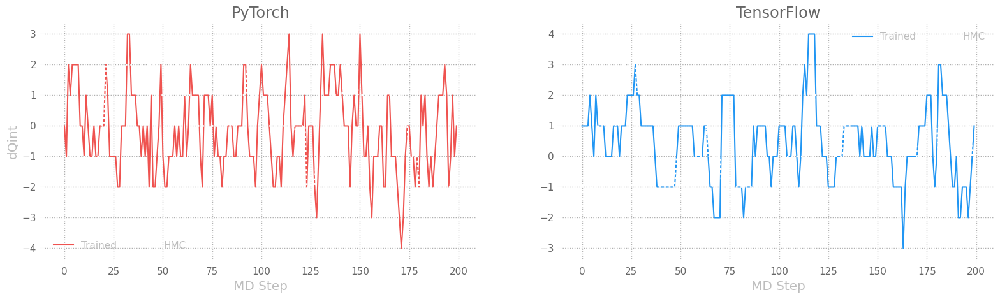

In [20]:
import matplotlib.pyplot as plt
from l2hmc.utils.plot_helpers import set_plot_style, COLORS

import seaborn as sns
set_plot_style()
plt.rcParams['axes.linewidth'] = 2.0
sns.set_context('notebook')
figsize = plt.rcParamsDefault['figure.figsize']
plt.rcParams['figure.dpi'] = plt.rcParamsDefault['figure.dpi']

for idx in range(4):
    fig, (ax, ax1) = plt.subplots(
        ncols=2,
        #nrows=4,
        figsize=(3. * figsize[0], figsize[1]),
    )
    _ = ax.plot(
        dsets['pt']['eval'].intQ[idx],  # .dQint.mean('chain')[100:],
        color=COLORS['red'],
        ls='-',
        label='Trained',
        lw=1.5,
    );

    _ = ax.plot(
        dsets['pt']['hmc'].intQ[idx],  # .dQint.mean('chain')[100:],
        ls=':',
        label='HMC',
        color='#ffffff',
        zorder=5,
        lw=2.0,
    );

    _ = ax1.plot(
        dsets['tf']['eval'].intQ[idx],  # .dQint.mean('chain')[-100:],
        color=COLORS['blue'],
        ls='-',
        label='Trained',
        lw=1.5,

    );
    _ = ax1.plot(
        dsets['tf']['hmc'].intQ[idx],  # .dQint.mean('chain')[-100:],
        color='#ffffff',
        ls=':',
        label='HMC',
        zorder=5,
        lw=2.0,
    );
    _ = ax.set_title('PyTorch', fontsize='x-large')
    _ = ax1.set_title('TensorFlow', fontsize='x-large')
    #_ = ax1.set_ylim(ax.get_ylim())
    _ = ax.grid(True, alpha=0.4)
    _ = ax1.grid(True, alpha=0.4)
    _ = ax.set_xlabel('MD Step', fontsize='large')
    _ = ax1.set_xlabel('MD Step', fontsize='large')
    _ = ax.set_ylabel('dQint', fontsize='large')
    _ = ax.legend(loc='best', framealpha=0.0, ncol=2, labelcolor='#bdbdbd')
    _ = ax1.legend(loc='best', framealpha=0.0, ncol=2, labelcolor='#bdbdbd')